<p><img alt="Colaboratory logo" height="45px" src="/img/colab_favicon.ico" align="left" hspace="10px" vspace="0px"></p>

<h1> Indentification Laylatul Qadr (LQ) by  API or Scraping Earth Temperature etc for Research Using Iqra Algorithm.ipynb</h1>

**************************************
By: Imam Cholissodin, S.Si., M.Kom. | imamcs@ub.ac.id | Dosen Fakultas Ilmu Komputer (Filkom), Universitas Brawijaya (UB) | Dibuat pada 29 September 2021 - 2022

Semoga Bermanfaat. Aamiin
**************************************

In [1]:
# ============================
# By: Imam Cholissodin | imamcs@ub.ac.id
# Fakultas Ilmu Komputer (Filkom)
# Universitas Brawijaya (UB)
# Tgl 26 April 2020 - 28 September 2021 - 2022
# Semoga Bermanfaat. Aamiin :D
# ====================================
from google.colab import drive
drive.mount('/content/drive')

# Ref:
# [0] https://jakevdp.github.io/blog/2012/08/18/matplotlib-animation-tutorial/
# 

Mounted at /content/drive


In [2]:
import os
from google.colab import output
os.chdir("/content/drive/My Drive")
path = "Penelitian_dan_Pengmas_2022/Get_Temperatur/MyApp"
if not os.path.exists(path):
  os.makedirs(path)
  os.chdir("/content/drive/My Drive/"+path)
  !gdown --id 1s60bscmRiEXPrXBrkz3iXn1HZ5UzGXTq
  !tar -xv -C './' -f './SmartAppRev7.tar'
  !mv ./SmartAppRev2 ./SmartApp
  !rm ./SmartAppRev7.tar

  # import fileinput
  # with fileinput.FileInput('./SmartApp/templates/index.html', inplace=True, backup='.bak') as file:
  #   for line in file:
  #       print(line.replace('Smart Data Application', 'My Data Application'), end='')

output.clear()
os.chdir("/content/drive/My Drive/"+path)

!pwd
!ls -l -a --block-size=M

# utk login
# ------------------------------------------------------------
# id | Mail as User     | Password | Name             | Level
# ------------------------------------------------------------
#  1 |	imamcs@ub.ac.id	|    a	   | Imam Cholissodin |	1
#  2 |  admin	          |   admin  | Imam Cholissodin |	1

# tabel utk simpan data suhu dll:
# data_suhu_dll_api_openweathermap => 1
# data_suhu_dll_api_weatherapi => 2
# data_suhu_dll_google_dot_com => 3
# data_suhu_dll_weather_dot_com => 4
# 

/content/drive/My Drive/Penelitian_dan_Pengmas_2022/Get_Temperatur/MyApp
total 7M
-rw------- 1 root root 1M May 22 12:49 afterMapping.html
-rw------- 1 root root 7M May  6 02:54 clustering.html
-rw------- 1 root root 1M Apr  3  2022 .env
drwx------ 2 root root 1M May  1 00:55 HasilAutoencoder
-rw------- 1 root root 1M May 21 01:36 HasilMapping.html
-rw------- 1 root root 1M Apr 30 04:53 hex_coords.html
drwx------ 2 root root 1M May  8 08:23 mpl_animationmanager
drwx------ 2 root root 1M Apr  2  2022 SmartApp


In [ ]:
# %%file ./.env
# NGROK_AUTH_TOKEN = ''

Overwriting ./.env


# Run Koding Flask

In [ ]:
# Instalasi Lib.
!pip install python-decouple
!pip install pyngrok --quiet
!pip install flask
!pip install flask_cors
!pip install db-sqlite3
!pip install freeport
!pip install cx_Oracle
!pip install flaskcode
output.clear()

# get token yang dihiden dalam file *.env 
from decouple import config
NGROK_AUTH_TOKEN = config('NGROK_AUTH_TOKEN',default='')

In [ ]:
%%file ./SmartApp/app.py

from flask import Flask,render_template,flash, Response, redirect,url_for,session,logging,request,jsonify,make_response
import sqlite3
from flask_cors import CORS
import os
import threading
from pyngrok import ngrok
import numpy as np
import pandas
from pandas import DataFrame
import os.path
import re
import string
import datetime
import json
from flask import send_file
from io import BytesIO

import cx_Oracle      # We are an Oracle shop, and this changes some things
import csv
# import StringIO       # allows you to store response object in memory instead of on disk
from io import StringIO
# from flask import make_response # Necessary imports, should be obvious

import flaskcode

os.environ["FLASK_ENV"] = "development"
app = Flask(__name__, static_folder='static')

CORS(app, resources=r'/api/*')

# app.debug = False
app.secret_key = 'key_app'



# app = Flask(__name__)
app.config.from_object(flaskcode.default_config)
# app.config['FLASKCODE_RESOURCE_BASEPATH'] = '/path/to/resource/folder'
app.config['FLASKCODE_RESOURCE_BASEPATH'] = './SmartApp'
app.register_blueprint(flaskcode.blueprint, url_prefix='/flaskcode')

@app.route("/")
def index():
    return render_template("index.html")

@app.route("/login",methods=["GET", "POST"])
def login():
  conn = connect_db()
  db = conn.cursor()
  msg = ""
  if request.method == "POST":
      mail = request.form["mail"]
      passw = request.form["passw"]

      rs = db.execute("SELECT * FROM user WHERE Mail=\'"+ mail +"\'"+" AND Password=\'"+ passw+"\'" + " LIMIT 1")

      conn.commit()

      hasil = []
      for v_login in rs:
          hasil.append(v_login)

      if hasil:
          session['name'] = v_login[3]
          return redirect(url_for("getsuhu_tipe_satu"))
      else:
          msg = "Masukkan Username (Email) dan Password dgn Benar!"

  return render_template("login.html", msg = msg)

@app.route("/register", methods=["GET", "POST"])
def register():
  conn = connect_db()
  db = conn.cursor()
  msg = ""
  if request.method == "POST":
      mail = request.form['mail']
      uname = request.form['uname']
      passw = request.form['passw']

      #cek apakah ada yg sudah menggunakan email tersebut
      rs = db.execute("SELECT * FROM user WHERE Mail=\'"+ mail +"\'" + " LIMIT 1")

      hasil = []
      for v_login in rs:
          hasil.append(v_login)

      if hasil:
          #msg = "Masukkan Username (Email) Lain, karena Email trsbt sudah digunakan oleh user Lainnya"
          msg = "Email trsbt sudah digunakan oleh user Lainnya"
          conn.commit()
          db.close()
          conn.close()
      else:
          if (bool(mail and not mail.isspace()) and bool(uname and not uname.isspace()) and bool(passw and not passw.isspace())):
              cmd = "insert into user(Mail, Password,Name,Level) values('{}','{}','{}','{}')".format(mail,passw,uname,'1')
              conn.execute(cmd)
              conn.commit()
              db.close()
              conn.close()
              #return redirect(url_for("login"))
              msg = "Masukkan Username (Email) dan Password dgn Benar!"
              return render_template("login.html", msg = msg)
          else:
              msg = "Lengkapi isian data Anda!"
  return render_template("register.html", msg = msg)

def connect_db():
    # import os.path
    # BASE_DIR = os.path.dirname(os.path.abspath(__file__))
    BASE_DIR = os.getcwd()+'/SmartApp'
    db_path = os.path.join(BASE_DIR, "data.db")
    return sqlite3.connect(db_path)

@app.errorhandler(404)
def page_not_found(error):
    return render_template("404.html")

@app.errorhandler(500)
def internal_server_error(error):
    return render_template("500.html")

@app.route('/getsuhu_tipe_satu', methods=["GET", "POST"])
def getsuhu_tipe_satu():

    if 'name' in session:
        name = session['name']
    else:
        name = 'Guest'

    # from datetime import date
    # Date = date.today().strftime("%d-%m-%Y")

    from datetime import datetime
    # from time import strftime
    import pytz
    Date = str(datetime.today().astimezone(pytz.timezone('Asia/Jakarta')).strftime('%d-%m-%Y %H:%M:%S'))

    # tabel utk simpan data suhu dll:
    # -------------------------------
    # data_suhu_dll_api_openweathermap => getsuhu_tipe_satu
    # data_suhu_dll_api_weatherapi => getsuhu_tipe_dua
    # data_suhu_dll_google_dot_com => getsuhu_tipe_tiga
    # data_suhu_dll_weather_dot_com => getsuhu_tipe_empat
    # 

    conn = connect_db()
    db = conn.cursor()

    c = db.execute(""" SELECT * FROM  data_suhu_dll_api_openweathermap """)

    mydata = c.fetchall()
    for x in c.fetchall():
        name_v=x[0]
        data_v=x[1]
        break

    hasil = []
    for v_login in c:
        hasil.append(v_login)

    conn.commit()
    db.close()
    conn.close()

    return render_template("getsuhu_tipe_satu.html", header = mydata)
    
@app.route('/getsuhu_tipe_dua', methods=["GET", "POST"])
def getsuhu_tipe_dua():

    if 'name' in session:
        name = session['name']
    else:
        name = 'Guest'

    # from datetime import date
    # Date = date.today().strftime("%d-%m-%Y")

    from datetime import datetime
    # from time import strftime
    import pytz
    Date = str(datetime.today().astimezone(pytz.timezone('Asia/Jakarta')).strftime('%d-%m-%Y %H:%M:%S'))

    # tabel utk simpan data suhu dll:
    # -------------------------------
    # data_suhu_dll_api_openweathermap => getsuhu_tipe_satu
    # data_suhu_dll_api_weatherapi => getsuhu_tipe_dua
    # data_suhu_dll_google_dot_com => getsuhu_tipe_tiga
    # data_suhu_dll_weather_dot_com => getsuhu_tipe_empat
    # 

    conn = connect_db()
    db = conn.cursor()

    c = db.execute(""" SELECT * FROM  data_suhu_dll_api_weatherapi """)

    mydata = c.fetchall()
    for x in c.fetchall():
        name_v=x[0]
        data_v=x[1]
        break

    hasil = []
    for v_login in c:
        hasil.append(v_login)

    conn.commit()
    db.close()
    conn.close()

    return render_template("getsuhu_tipe_dua.html", header = mydata)

@app.route('/getsuhu_tipe_tiga', methods=["GET", "POST"])
def getsuhu_tipe_tiga():

    if 'name' in session:
        name = session['name']
    else:
        name = 'Guest'

    # from datetime import date
    # Date = date.today().strftime("%d-%m-%Y")

    from datetime import datetime
    # from time import strftime
    import pytz
    Date = str(datetime.today().astimezone(pytz.timezone('Asia/Jakarta')).strftime('%d-%m-%Y %H:%M:%S'))

    # tabel utk simpan data suhu dll:
    # -------------------------------
    # data_suhu_dll_api_openweathermap => getsuhu_tipe_satu
    # data_suhu_dll_api_weatherapi => getsuhu_tipe_dua
    # data_suhu_dll_google_dot_com => getsuhu_tipe_tiga
    # data_suhu_dll_weather_dot_com => getsuhu_tipe_empat
    # 

    conn = connect_db()
    db = conn.cursor()

    c = db.execute(""" SELECT * FROM  data_suhu_dll_google_dot_com """)

    mydata = c.fetchall()
    for x in c.fetchall():
        name_v=x[0]
        data_v=x[1]
        break

    hasil = []
    for v_login in c:
        hasil.append(v_login)

    conn.commit()
    db.close()
    conn.close()

    return render_template("getsuhu_tipe_tiga.html", header = mydata)
    
@app.route('/getsuhu_tipe_empat', methods=["GET", "POST"])
def getsuhu_tipe_empat():

    if 'name' in session:
        name = session['name']
    else:
        name = 'Guest'

    # from datetime import date
    # Date = date.today().strftime("%d-%m-%Y")

    from datetime import datetime
    # from time import strftime
    import pytz
    Date = str(datetime.today().astimezone(pytz.timezone('Asia/Jakarta')).strftime('%d-%m-%Y %H:%M:%S'))

    # tabel utk simpan data suhu dll:
    # -------------------------------
    # data_suhu_dll_api_openweathermap => getsuhu_tipe_satu
    # data_suhu_dll_api_weatherapi => getsuhu_tipe_dua
    # data_suhu_dll_google_dot_com => getsuhu_tipe_tiga
    # data_suhu_dll_weather_dot_com => getsuhu_tipe_empat
    # 

    conn = connect_db()
    db = conn.cursor()

    c = db.execute(""" SELECT * FROM  data_suhu_dll_weather_dot_com """)

    mydata = c.fetchall()
    for x in c.fetchall():
        name_v=x[0]
        data_v=x[1]
        break

    hasil = []
    for v_login in c:
        hasil.append(v_login)

    conn.commit()
    db.close()
    conn.close()

    return render_template("getsuhu_tipe_empat.html", header = mydata)

@app.route('/del_data_tipe_satu/', methods=["GET"])
def del_data_tipe_satu():
    date = request.args.get('date')
    kota = request.args.get('kota')
    conn = connect_db()
    db = conn.cursor()

    # tabel utk simpan data suhu dll:
    # -------------------------------
    # data_suhu_dll_api_openweathermap
    # data_suhu_dll_api_weatherapi
    # data_suhu_dll_google_dot_com
    # data_suhu_dll_weather_dot_com
    # 
    # nama kolom:
    # ------------
    # date, kota, suhu_dlm_celcius, 
    # precipitation_curah_hujan_dlm_persen, humidity_kelembaban_dlm_persen, 
    # wind_angin_dlm_km_per_jam

    db.execute("DELETE FROM data_suhu_dll WHERE date =\'"+ date +"\' AND kota =\'"+ kota +"\'")

    conn.commit()
    db.close()
    conn.close()

    return redirect(url_for("getsuhu_dll"))

@app.route('/unduh_data_tipe_satu/', methods=["GET"])
def dw_data_tipe_satu():
    # name = request.args.get('name')
    conn = connect_db()
    db = conn.cursor()

    c = db.execute("SELECT * FROM data_suhu_dll_api_openweathermap")

    # for x in c.fetchall():
    #     name_v='data.csv'
    #     # data_v=x[3]
    #     break

    # return Response(
    #     csv,
    #     mimetype="text/csv",
    #     headers={"Content-disposition":
    #              "attachment; filename=myplot.csv"})

    # def export(load_file_id):
    si = StringIO()
    cw = csv.writer(si)
    # c = g.db.cursor()
    # c.execute('SELECT * FROM TABLE WHERE column_val = :identifier', identifier=identifier)
    # c.execute('SELECT * FROM data_suhu_dll_api_openweathermap')
    rows = c.fetchall()
    cw.writerow([i[0] for i in c.description])
    cw.writerows(rows)
    response = make_response(si.getvalue())
    response.headers['Content-Disposition'] = 'attachment; filename=data.csv'
    response.headers["Content-type"] = "text/csv"
    


    conn.commit()
    db.close()
    conn.close()

    # return send_file(BytesIO(data_v), attachment_filename=name_v, as_attachment=True)
    # return send_file(BytesIO(name_v), attachment_filename=name_v, as_attachment=True)
    # return Response(c.fetchall(),mimetype="text/csv",headers={"Content-disposition":"attachment; filename=data.csv"})

    return response

@app.route('/logout')
def logout():
   # remove the name from the session if it is there
   session.pop('name', None)
   return redirect(url_for('index'))

@app.route("/p2021",methods=["GET", "POST"])
def p2021():
  conn = connect_db()
  db = conn.cursor()
  msg = ""

  return render_template("docs/assets/index.html", msg = msg)

# * Tip: There are .env or .flaskenv files present. Do "pip install python-dotenv" to use them.
# if __name__ == '__main__':
#   app.run() 
#   # app.run(host='0.0.0.0', port=5004)

# Start the Flask server in a new thread
threading.Thread(target=app.run, kwargs={"use_reloader": False}).start()

Overwriting ./SmartApp/app.py


In [ ]:
!pwd

/content/drive/MyDrive/Penelitian_dan_Pengmas_2022/Get_Temperatur/MyApp


In [ ]:
# !cat ./SmartApp/templates/getsuhu_tipe_satu.html

In [ ]:
# !cat ./SmartApp/static/js/site.js.download

In [ ]:
!python ./SmartApp/app.py

In [ ]:
# cara run Flask IoT Simulator
!echo yes | freeport 5000
output.clear()
get_ipython().system_raw('python ./SmartApp/app.py --host=0.0.0.0 --port=5000 &')

In [ ]:
ngrok.kill()

In [ ]:
from pyngrok import ngrok

#terminate open tunnels if exist
ngrok.kill()

#Setting the authtoken (optional)
#Get your authtoken from htpps://dashboard.ngrok.com/auth
# NGROK_AUTH_TOKEN_ALT = ""
ngrok.set_auth_token(NGROK_AUTH_TOKEN)
ngrok.connect(5000)

<NgrokTunnel: "http://cad4-34-90-240-76.ngrok.io" -> "http://localhost:5000">

In [ ]:
# [v] data_suhu_dll_api_openweathermap => getsuhu_tipe_satu
# data_suhu_dll_api_weatherapi => getsuhu_tipe_dua
# data_suhu_dll_google_dot_com => getsuhu_tipe_tiga
# data_suhu_dll_weather_dot_com => getsuhu_tipe_empat

os.chdir("/content/drive/My Drive/"+path+'/SmartApp')

import requests
# import re
# from bs4 import BeautifulSoup
import sqlite3
import os.path
import os
# import time
from datetime import datetime
# from time import strftime
import pytz
Date = datetime.today().astimezone(pytz.timezone('Asia/Jakarta')).strftime('%d-%m-%Y %H:%M:%S')

# def scrapMarketwatch(address):
#     #creating formatting data from scrapdata
#     r = requests.get(address)
#     c = r.content
#     sup = bs(c,"html.parser")
#     # print(sup)
#     return sup
def F2C(f_in):
    return (f_in - 32)* 5/9

def Kelvin2C(k_in):
  return (k_in-273.15)

def connect_db():

    # BASE_DIR = os.path.dirname(os.path.abspath(__file__))
    BASE_DIR = os.getcwd()
    db_path = os.path.join(BASE_DIR, "data.db")
    # with sqlite3.connect(db_path) as db:

    return sqlite3.connect(db_path)


# simpan ke db
conn = connect_db()
db = conn.cursor()

db.execute("""CREATE TABLE IF NOT EXISTS data_suhu_dll_api_openweathermap (date DATETIME, kota TEXT, suhu_dlm_celcius TEXT, precipitation_curah_hujan_dlm_persen TEXT, humidity_kelembaban_dlm_persen TEXT, wind_angin_dlm_km_per_jam TEXT) """)

# siang
# jam 6 pagi - 18.00
#
# malam
# jam 18.00 - 6 pagi

# Ref. daerah di negara lain yang selisihnya -/+[6/1/2], dll jam dgn Indonesia
# [0] https://time.is/id/Jakarta#time_zone
# [1] https://www.kompas.com/skola/read/2021/03/04/120155469/tabel-perbedaan-waktu-di-indonesia-dengan-negara-lainnya
#

# Perbedaan waktu dari Jakarta:
# Los Angeles		−14 jam
# Chicago			−12 jam
# New York City	    −11 jam
# Toronto			−11 jam
# São Paulo	    	−10 jam
# UTC				−7 jam
# Lagos		    	−6 jam
# London			−6 jam
# Johannesburg  	−5 jam
# Kairo		    	−5 jam
# Paris		    	−5 jam
# Zurich			−5 jam
# Istanbul	    	−4 jam
# Moskwa			−4 jam
# Dubai		    	−3 jam
# Mumbai			−1,5 jam
# Hong Kong	    	+1 jam
# Shanghai	    	+1 jam
# Singapura	    	+1 jam
# Tokyo		    	+2 jam
# Sydney			+4 jam

# list_kota = ['Jakarta, Indonesia As of 8:52 am WIB',\
# 'Los Angeles, CA As of 6:40 pm PDT',\
# 'Chicago, IL As of 8:54 pm CDT', \
# 'New York City, NY As of 9:54 pm EDT',\
# 'Toronto, Ontario, Canada As of 9:43 pm EDT',\
# 'São Paulo, São Paulo, Brazil As of 10:58 pm BRT', \
# 'Lagos, Lagos, Nigeria As of 2:51 am WAT', \
# 'London, England, United Kingdom As of 2:53 am BST', \
# 'Johannesburg, Gauteng, South Africa As of 4:01 am SAST',\
# 'Cairo, Cairo, Egypt As of 3:50 am EET', \
# 'Paris, France As of 3:56 am CEST', \
# 'Zurich, Zürich, Switzerland As of 3:49 am CEST', \
# 'Istanbul, Turkey As of 4:58 am EET', \
# 'Moscow, Moscow, Russia As of 4:55 am MSK', \
# 'Dubai, Dubai, United Arab Emirates As of 6:02 am GST', \
# 'Mumbai, Maharashtra, India As of 7:24 am IST',\
# 'Hong Kong, People's Republic of China As of 10:01 am HKT',\
# 'Shanghai, People's Republic of China As of 10:01 am CST',\
# 'Singapore, Central, Singapore As of 9:59 am SGT',\
# 'Tokyo, Tokyo Prefecture, Japan As of 10:52 am JST',\
# 'Sydney, New South Wales, Australia As of 1:02 pm AEDT']

list_kota = ['Jakarta','Los Angeles','Chicago','New York City','Toronto','São Paulo', \
             'Lagos', 'London', 'Johannesburg', 'Kairo', 'Paris', 'Zurich', 'Istanbul', 'Moskwa', 'Dubai', \
            'Mumbai','Hong Kong','Shanghai','Singapura','Tokyo','Sydney']


for nama_kota in list_kota:

  #each_list_link='http://api.weatherapi.com/v1/current.json?key=2181c95fd6d746e9a1331323220104&q='+nama_kota
  each_list_link='https://api.openweathermap.org/data/2.5/weather?q='+nama_kota+'&appid=7cdce363ecc74c5fa44be2acaa031dbc'
  resp=requests.get(each_list_link)

  #http_respone 200 means OK status
  if resp.status_code==200:
      resp=resp.json()
      suhu = Kelvin2C(float(resp['main']['temp']))
      curah_hujan = '-'
      lembab = resp['main']['humidity']
      angin = resp['wind']['speed']
  else:
      # print("Error")
      suhu = '-'
      curah_hujan = '-'
      lembab = '-'
      angin = '-'

  db.execute("""INSERT INTO data_suhu_dll_api_openweathermap (date, kota, suhu_dlm_celcius, precipitation_curah_hujan_dlm_persen, humidity_kelembaban_dlm_persen, wind_angin_dlm_km_per_jam) VALUES (?,?,?,?,?,?) """,(Date,nama_kota,suhu,curah_hujan,lembab,angin))


conn.commit()
db.close()
conn.close()

os.chdir("/content/drive/My Drive/"+path)

In [ ]:
BASE_DIR = os.getcwd()+'/SmartApp'
db_path = os.path.join(BASE_DIR, "data.db")

In [ ]:
print(db_path)

/content/drive/My Drive/Penelitian_dan_Pengmas_2022/Get_Temperatur/MyApp/SmartApp/SmartApp/data.db


In [ ]:
# data_suhu_dll_api_openweathermap => getsuhu_tipe_satu
# [v] data_suhu_dll_api_weatherapi => getsuhu_tipe_dua
# data_suhu_dll_google_dot_com => getsuhu_tipe_tiga
# data_suhu_dll_weather_dot_com => getsuhu_tipe_empat

os.chdir("/content/drive/My Drive/"+path+'/SmartApp')

import requests
# import re
# from bs4 import BeautifulSoup
import sqlite3
import os.path
import os
# import time
from datetime import datetime
# from time import strftime
import pytz

from decouple import config
KEY_WEATHER_API = '2181c95fd6d746e9a1331323220104'
# KEY_WEATHER_API = config('KEY_WEATHER_API',default='')

Date = datetime.today().astimezone(pytz.timezone('Asia/Jakarta')).strftime('%d-%m-%Y %H:%M:%S')

# def scrapMarketwatch(address):
#     #creating formatting data from scrapdata
#     r = requests.get(address)
#     c = r.content
#     sup = bs(c,"html.parser")
#     # print(sup)
#     return sup
def F2C(f_in):
    return (f_in - 32)* 5/9

def Kelvin2C(k_in):
  return (k_in-273.15)

def connect_db():
    

    # BASE_DIR = os.path.dirname(os.path.abspath(__file__))
    BASE_DIR = os.getcwd()
    db_path = os.path.join(BASE_DIR, "data.db")
    # with sqlite3.connect(db_path) as db:

    return sqlite3.connect(db_path)


# simpan ke db
conn = connect_db()
db = conn.cursor()

db.execute("""CREATE TABLE IF NOT EXISTS data_suhu_dll_api_weatherapi (date DATETIME, kota TEXT, suhu_dlm_celcius TEXT, precipitation_curah_hujan_dlm_persen TEXT, humidity_kelembaban_dlm_persen TEXT, wind_angin_dlm_km_per_jam TEXT) """)

# Ref. daerah di negara lain yang selisihnya -/+[6/1/2], dll jam dgn Indonesia
# [0] https://time.is/id/Jakarta#time_zone
# [1] https://www.kompas.com/skola/read/2021/03/04/120155469/tabel-perbedaan-waktu-di-indonesia-dengan-negara-lainnya
#

# Perbedaan waktu dari Jakarta:
# Los Angeles		−14 jam
# Chicago			−12 jam
# New York City	    −11 jam
# Toronto			−11 jam
# São Paulo	    	−10 jam
# UTC				−7 jam
# Lagos		    	−6 jam
# London			−6 jam
# Johannesburg  	−5 jam
# Kairo		    	−5 jam
# Paris		    	−5 jam
# Zurich			−5 jam
# Istanbul	    	−4 jam
# Moskwa			−4 jam
# Dubai		    	−3 jam
# Mumbai			−1,5 jam
# Hong Kong	    	+1 jam
# Shanghai	    	+1 jam
# Singapura	    	+1 jam
# Tokyo		    	+2 jam
# Sydney			+4 jam

# list_kota = ['Jakarta, Indonesia As of 8:52 am WIB',\
# 'Los Angeles, CA As of 6:40 pm PDT',\
# 'Chicago, IL As of 8:54 pm CDT', \
# 'New York City, NY As of 9:54 pm EDT',\
# 'Toronto, Ontario, Canada As of 9:43 pm EDT',\
# 'São Paulo, São Paulo, Brazil As of 10:58 pm BRT', \
# 'Lagos, Lagos, Nigeria As of 2:51 am WAT', \
# 'London, England, United Kingdom As of 2:53 am BST', \
# 'Johannesburg, Gauteng, South Africa As of 4:01 am SAST',\
# 'Cairo, Cairo, Egypt As of 3:50 am EET', \
# 'Paris, France As of 3:56 am CEST', \
# 'Zurich, Zürich, Switzerland As of 3:49 am CEST', \
# 'Istanbul, Turkey As of 4:58 am EET', \
# 'Moscow, Moscow, Russia As of 4:55 am MSK', \
# 'Dubai, Dubai, United Arab Emirates As of 6:02 am GST', \
# 'Mumbai, Maharashtra, India As of 7:24 am IST',\
# 'Hong Kong, People's Republic of China As of 10:01 am HKT',\
# 'Shanghai, People's Republic of China As of 10:01 am CST',\
# 'Singapore, Central, Singapore As of 9:59 am SGT',\
# 'Tokyo, Tokyo Prefecture, Japan As of 10:52 am JST',\
# 'Sydney, New South Wales, Australia As of 1:02 pm AEDT']

list_kota = ['Jakarta','Los Angeles','Chicago','New York City','Toronto','São Paulo', \
             'Lagos', 'London', 'Johannesburg', 'Kairo', 'Paris', 'Zurich', 'Istanbul', 'Moskwa', 'Dubai', \
            'Mumbai','Hong Kong','Shanghai','Singapura','Tokyo','Sydney']


for nama_kota in list_kota:

  each_list_link='http://api.weatherapi.com/v1/current.json?key='+KEY_WEATHER_API+'&q='+nama_kota
  resp=requests.get(each_list_link)

  #http_respone 200 means OK status
  if resp.status_code==200:
      resp=resp.json()
      suhu = resp['current']['temp_c']
      curah_hujan = resp['current']['precip_mm']
      lembab = resp['current']['humidity']
      angin = resp['current']['wind_mph']
  else:
      # print("Error")
      suhu = '-'
      curah_hujan = '-'
      lembab = '-'
      angin = '-'

  db.execute("""INSERT INTO data_suhu_dll_api_weatherapi (date, kota, suhu_dlm_celcius, precipitation_curah_hujan_dlm_persen, humidity_kelembaban_dlm_persen, wind_angin_dlm_km_per_jam) VALUES (?,?,?,?,?,?) """,(Date,nama_kota,suhu,curah_hujan,lembab,angin))


conn.commit()
db.close()
conn.close()

os.chdir("/content/drive/My Drive/"+path)

In [ ]:
# data_suhu_dll_api_openweathermap => getsuhu_tipe_satu
# data_suhu_dll_api_weatherapi => getsuhu_tipe_dua
# [v] data_suhu_dll_google_dot_com => getsuhu_tipe_tiga
# data_suhu_dll_weather_dot_com => getsuhu_tipe_empat

os.chdir("/content/drive/My Drive/"+path+'/SmartApp')

import requests
# import re
from bs4 import BeautifulSoup
import sqlite3
import os.path
import os
# import time
from datetime import datetime
# from time import strftime
import pytz

# import str

# Date = str(datetime.today().astimezone(pytz.timezone('Asia/Jakarta')).strftime('%d-%m-%Y %H:%M:%S'))
Date = datetime.today().astimezone(pytz.timezone('Asia/Jakarta')).strftime('%d-%m-%Y %H:%M:%S')

# def scrapMarketwatch(address):
#     #creating formatting data from scrapdata
#     r = requests.get(address)
#     c = r.content
#     sup = bs(c,"html.parser")
#     # print(sup)
#     return sup
def F2C(f_in):
    return (f_in - 32)* 5/9

def Kelvin2C(k_in):
  return (k_in-273.15)

def connect_db():
    # BASE_DIR = os.path.dirname(os.path.abspath(__file__))
    BASE_DIR = os.getcwd()
    db_path = os.path.join(BASE_DIR, "data.db")
    # with sqlite3.connect(db_path) as db:

    return sqlite3.connect(db_path)

# simpan ke db
conn = connect_db()
db = conn.cursor()

db.execute("""CREATE TABLE IF NOT EXISTS data_suhu_dll_google_dot_com (date DATETIME, kota TEXT, suhu_dlm_celcius TEXT, precipitation_curah_hujan_dlm_persen TEXT, humidity_kelembaban_dlm_persen TEXT, wind_angin_dlm_km_per_jam TEXT) """)

# Ref. daerah di negara lain yang selisihnya -/+[6/1/2], dll jam dgn Indonesia
# [0] https://time.is/id/Jakarta#time_zone
# [1] https://www.kompas.com/skola/read/2021/03/04/120155469/tabel-perbedaan-waktu-di-indonesia-dengan-negara-lainnya
#

# Perbedaan waktu dari Jakarta:
# Los Angeles		−14 jam
# Chicago			−12 jam
# New York City	    −11 jam
# Toronto			−11 jam
# São Paulo	    	−10 jam
# UTC				−7 jam
# Lagos		    	−6 jam
# London			−6 jam
# Johannesburg  	−5 jam
# Kairo		    	−5 jam
# Paris		    	−5 jam
# Zurich			−5 jam
# Istanbul	    	−4 jam
# Moskwa			−4 jam
# Dubai		    	−3 jam
# Mumbai			−1,5 jam
# Hong Kong	    	+1 jam
# Shanghai	    	+1 jam
# Singapura	    	+1 jam
# Tokyo		    	+2 jam
# Sydney			+4 jam

# list_kota = ['Jakarta, Indonesia As of 8:52 am WIB',\
# 'Los Angeles, CA As of 6:40 pm PDT',\
# 'Chicago, IL As of 8:54 pm CDT', \
# 'New York City, NY As of 9:54 pm EDT',\
# 'Toronto, Ontario, Canada As of 9:43 pm EDT',\
# 'São Paulo, São Paulo, Brazil As of 10:58 pm BRT', \
# 'Lagos, Lagos, Nigeria As of 2:51 am WAT', \
# 'London, England, United Kingdom As of 2:53 am BST', \
# 'Johannesburg, Gauteng, South Africa As of 4:01 am SAST',\
# 'Cairo, Cairo, Egypt As of 3:50 am EET', \
# 'Paris, France As of 3:56 am CEST', \
# 'Zurich, Zürich, Switzerland As of 3:49 am CEST', \
# 'Istanbul, Turkey As of 4:58 am EET', \
# 'Moscow, Moscow, Russia As of 4:55 am MSK', \
# 'Dubai, Dubai, United Arab Emirates As of 6:02 am GST', \
# 'Mumbai, Maharashtra, India As of 7:24 am IST',\
# 'Hong Kong, People's Republic of China As of 10:01 am HKT',\
# 'Shanghai, People's Republic of China As of 10:01 am CST',\
# 'Singapore, Central, Singapore As of 9:59 am SGT',\
# 'Tokyo, Tokyo Prefecture, Japan As of 10:52 am JST',\
# 'Sydney, New South Wales, Australia As of 1:02 pm AEDT']

list_kota = ['Jakarta','Los Angeles','Chicago','New York City','Toronto','São Paulo', \
             'Lagos', 'London', 'Johannesburg', 'Kairo', 'Paris', 'Zurich', 'Istanbul', 'Moskwa', 'Dubai', \
            'Mumbai','Hong Kong','Shanghai','Singapura','Tokyo','Sydney']


for nama_kota in list_kota:

  # enter city name
  city = nama_kota
  
  # creating url and requests instance
  url = "https://www.google.com/search?q="+"weather"+city
  html_init = requests.get(url)

  # resp=requests.get(each_list_link)  

  #http_respone 200 means OK status
  if html_init.status_code==200:
      html = html_init.content

      # getting raw data
      soup = BeautifulSoup(html, 'html.parser')
      temp_init = soup.find('div', attrs={'class': 'BNeawe iBp4i AP7Wnd'})

      if temp_init is not None:
        temp = temp_init.text
        str_init = soup.find('div', attrs={'class': 'BNeawe tAd8D AP7Wnd'}).text
        
        # formatting data
        data = str_init.split('\n')
        time = data[0]
        sky = data[1]
        
        # getting all div tag
        listdiv = soup.findAll('div', attrs={'class': 'BNeawe s3v9rd AP7Wnd'})
        strd = listdiv[5].text
        
        # getting other required data
        pos = strd.find('Wind')
        other_data = strd[pos:]
        
        # printing all data
        # print("Temperature is", temp)
        # print("Time: ", time)
        # print("Sky Description: ", sky)
        # print(other_data)
        
        int_hasil = int(''.join([n for n in temp if n.isdigit()]))
        # suhu = F2C(int_hasil)
        # print(suhu)

        suhu = F2C(int_hasil)
      else:
        suhu = '-'

      
      curah_hujan = '-'
      lembab = sky if sky is not None else '-'
      angin = other_data if other_data is not None else '-'
  else:
      # print("Error")
      suhu = '-'
      curah_hujan = '-'
      lembab = '-'
      angin = '-'

  db.execute("""INSERT INTO data_suhu_dll_google_dot_com (date, kota, suhu_dlm_celcius, precipitation_curah_hujan_dlm_persen, humidity_kelembaban_dlm_persen, wind_angin_dlm_km_per_jam) VALUES (?,?,?,?,?,?) """,(Date,nama_kota,suhu,curah_hujan,lembab,angin))


conn.commit()
db.close()
conn.close()

os.chdir("/content/drive/My Drive/"+path)

In [ ]:
# data_suhu_dll_api_openweathermap => getsuhu_tipe_satu
# data_suhu_dll_api_weatherapi => getsuhu_tipe_dua
# data_suhu_dll_google_dot_com => getsuhu_tipe_tiga
# [v] data_suhu_dll_weather_dot_com => getsuhu_tipe_empat

os.chdir("/content/drive/My Drive/"+path+'/SmartApp')

import requests
# import re
from bs4 import BeautifulSoup
import sqlite3
import os.path
import os
# import time
from datetime import datetime
# from time import strftime
import pytz
Date = datetime.today().astimezone(pytz.timezone('Asia/Jakarta')).strftime('%d-%m-%Y %H:%M:%S')

# def scrapMarketwatch(address):
#     #creating formatting data from scrapdata
#     r = requests.get(address)
#     c = r.content
#     sup = bs(c,"html.parser")
#     # print(sup)
#     return sup
def F2C(f_in):
    return (f_in - 32)* 5/9

def connect_db():
    BASE_DIR = os.getcwd()
    db_path = os.path.join(BASE_DIR, "data.db")
    # with sqlite3.connect(db_path) as db:

    return sqlite3.connect(db_path)


# simpan ke db
conn = connect_db()
db = conn.cursor()

db.execute("""CREATE TABLE IF NOT EXISTS data_suhu_dll_weather_dot_com (date DATETIME, kota TEXT, suhu_dlm_celcius TEXT, precipitation_curah_hujan_dlm_persen TEXT, humidity_kelembaban_dlm_persen TEXT, wind_angin_dlm_km_per_jam TEXT) """)

# Ref. daerah di negara lain yang selisihnya -/+[6/1/2], dll jam dgn Indonesia
# [0] https://time.is/id/Jakarta#time_zone
# [1] https://www.kompas.com/skola/read/2021/03/04/120155469/tabel-perbedaan-waktu-di-indonesia-dengan-negara-lainnya
#

# Perbedaan waktu dari Jakarta:
# Los Angeles		−14 jam
# Chicago			−12 jam
# New York City	    −11 jam
# Toronto			−11 jam
# São Paulo	    	−10 jam
# UTC				−7 jam
# Lagos		    	−6 jam
# London			−6 jam
# Johannesburg  	−5 jam
# Kairo		    	−5 jam
# Paris		    	−5 jam
# Zurich			−5 jam
# Istanbul	    	−4 jam
# Moskwa			−4 jam
# Dubai		    	−3 jam
# Mumbai			−1,5 jam
# Hong Kong	    	+1 jam
# Shanghai	    	+1 jam
# Singapura	    	+1 jam
# Tokyo		    	+2 jam
# Sydney			+4 jam

# list_kota = ['Jakarta, Indonesia As of 8:52 am WIB',\
# 'Los Angeles, CA As of 6:40 pm PDT',\
# 'Chicago, IL As of 8:54 pm CDT', \
# 'New York City, NY As of 9:54 pm EDT',\
# 'Toronto, Ontario, Canada As of 9:43 pm EDT',\
# 'São Paulo, São Paulo, Brazil As of 10:58 pm BRT', \
# 'Lagos, Lagos, Nigeria As of 2:51 am WAT', \
# 'London, England, United Kingdom As of 2:53 am BST', \
# 'Johannesburg, Gauteng, South Africa As of 4:01 am SAST',\
# 'Cairo, Cairo, Egypt As of 3:50 am EET', \
# 'Paris, France As of 3:56 am CEST', \
# 'Zurich, Zürich, Switzerland As of 3:49 am CEST', \
# 'Istanbul, Turkey As of 4:58 am EET', \
# 'Moscow, Moscow, Russia As of 4:55 am MSK', \
# 'Dubai, Dubai, United Arab Emirates As of 6:02 am GST', \
# 'Mumbai, Maharashtra, India As of 7:24 am IST',\
# 'Hong Kong, People's Republic of China As of 10:01 am HKT',\
# 'Shanghai, People's Republic of China As of 10:01 am CST',\
# 'Singapore, Central, Singapore As of 9:59 am SGT',\
# 'Tokyo, Tokyo Prefecture, Japan As of 10:52 am JST',\
# 'Sydney, New South Wales, Australia As of 1:02 pm AEDT']

list_kota = ['Jakarta','Los Angeles','Chicago','New York City','Toronto','São Paulo', \
             'Lagos', 'London', 'Johannesburg', 'Kairo', 'Paris', 'Zurich', 'Istanbul', 'Moskwa', 'Dubai', \
            'Mumbai','Hong Kong','Shanghai','Singapura','Tokyo','Sydney']

list_link_kota = ['https://weather.com/weather/today/l/363e9580fc9dcc8e3ab95158a9435cd81609c821e02330d47b121ea1d65771dc',\
             'https://weather.com/weather/today/l/a4bf563aa6c1d3b3daffff43f51e3d7f765f43968cddc0475b9f340601b8cc26',\
             'https://weather.com/weather/today/l/e0abde3003a88dedecad92fedc96375000c16843287a51dbf2cd92f062217180',\
             'https://weather.com/weather/today/l/96f2f84af9a5f5d452eb0574d4e4d8a840c71b05e22264ebdc0056433a642c84',\
             'https://weather.com/weather/today/l/d8ccf908e3c4c748e232720575df7cdbca6e0f1b412bca8595d8a28d0c28e8bc',\
             'https://weather.com/weather/today/l/63e18eea74a484c42c3921cf52a8fec98113dbb13f6deb7c477b2f453c95b837', \
             'https://weather.com/weather/today/l/7d391501221842b79c58c5260dbafbe2305deffed37a075972092251243a4ad8', \
             'https://weather.com/weather/today/l/ae8230efd4bc57fdf721a02c7eb2b88c56aa6e71d73666328e33af3ea2039032132e24ae91b6a07862c5091a9d95a4b8',\
             'https://weather.com/weather/today/l/bcc7d09eb5f3638e22dbb8465eeb4065b24ccc12e1b02891643c18d30410ba41', \
             'https://weather.com/weather/today/l/2baa93f2531b18395e9b0062c11ffee82838615b3ac6141394235eb734bac64d', \
             'https://weather.com/weather/today/l/1a8af5b9d8971c46dd5a52547f9221e22cd895d8d8639267a87df614d0912830', \
             'https://weather.com/weather/today/l/151d93a8aa1a5fa8c93142a2499b472960ea57c494977eecdd6810dabed490df', \
             'https://weather.com/weather/today/l/33d1e415eb66f3e1ab35c3add45fccf4512715d329edbd91c806a6957e123b49', \
             'https://weather.com/weather/today/l/34f2aafc84cff75ae0b014754856ea5e7f8ddf618cf9735549dfb5e016c28e10', \
             'https://weather.com/weather/today/l/af60f113ba123ce93774fed531be2e1e51a1666be5d6012f129cfa27bae1ee6c', \
             'https://weather.com/weather/today/l/e1bbaf5ba44a74170e3bb9f892416301c36b3b17f37e1a666c6e1213de0f5668',\
             'https://weather.com/weather/today/l/8f0658124f5f5b725ca5ed254decc028fd2099a8ac1843faa2ceb206c9b464d1',\
             'https://weather.com/weather/today/l/7f14186934f484d567841e8646abc61b81cce4d88470d519beeb5e115c9b425a',\
             'https://weather.com/weather/today/l/bfbafb71cea3672231349f36b198478ecc3d5fd524d0918b8051ee838f743675',\
             'https://weather.com/weather/today/l/4ba28384e2da53b2861f5b5c70b7332e4ba1dc83e75b948e6fbd2aaceeeceae3',\
             'https://weather.com/weather/today/l/98ef17e6662508c0af6d8bd04adacecde842fb533434fcd2c046730675fba371']

for each_list_link in list_link_kota:
  #open with GET method
  resp=requests.get(each_list_link)

  nama_kota = list_kota[list_link_kota.index(each_list_link)]

  #http_respone 200 means OK status
  if resp.status_code==200:
      soup=BeautifulSoup(resp.text,'html.parser')
      divs = soup.find("span", {"class": "CurrentConditions--tempValue--3a50n","data-testid":"TemperatureValue"}, partial=False)
      int_hasil = int(''.join([n for n in divs.text if n.isdigit()]))
      suhu = F2C(int_hasil)
      curah_hujan = '-'
      lembab = '-'
      angin = '-'
      # print(F2C(int_hasil))
  else:
      # print("Error")
      suhu = '-'
      curah_hujan = '-'
      lembab = '-'
      angin = '-'

  db.execute("""INSERT INTO data_suhu_dll_weather_dot_com (date, kota, suhu_dlm_celcius, precipitation_curah_hujan_dlm_persen, humidity_kelembaban_dlm_persen, wind_angin_dlm_km_per_jam) VALUES (?,?,?,?,?,?) """,(Date,nama_kota,suhu,curah_hujan,lembab,angin))


conn.commit()
db.close()
conn.close()

os.chdir("/content/drive/My Drive/"+path)

In [3]:
!ls

afterMapping.html  HasilAutoencoder   hex_coords.html	    SmartApp
clustering.html    HasilMapping.html  mpl_animationmanager


In [4]:
!pwd

/content/drive/MyDrive/Penelitian_dan_Pengmas_2022/Get_Temperatur/MyApp


# Analisis Data

In [ ]:
import sqlite3
import pandas as pd
import time
from datetime import datetime, timezone
from time import gmtime, strftime
import pytz
def connect_db():
    BASE_DIR = os.getcwd()
    db_path = os.path.join(BASE_DIR, "SmartApp/dataset_for_ramadan.db")
    # with sqlite3.connect(db_path) as db:

    return sqlite3.connect(db_path)


# simpan ke db
conn = connect_db()
db = conn.cursor()

# db.execute("""CREATE TABLE IF NOT EXISTS data_suhu_dll_weather_dot_com (date DATETIME, kota TEXT, suhu_dlm_celcius TEXT, precipitation_curah_hujan_dlm_persen TEXT, humidity_kelembaban_dlm_persen TEXT, wind_angin_dlm_km_per_jam TEXT) """)

# db.execute("""INSERT INTO data_suhu_dll_weather_dot_com (date, kota, suhu_dlm_celcius, precipitation_curah_hujan_dlm_persen, humidity_kelembaban_dlm_persen, wind_angin_dlm_km_per_jam) VALUES (?,?,?,?,?,?) """,(Date,nama_kota,suhu,curah_hujan,lembab,angin))

c = db.execute(""" SELECT * FROM  data_suhu_dll """)

mydata = c.fetchall()

conn.commit()
db.close()
conn.close()

In [ ]:
db = sqlite3.connect("./SmartApp/dataset_for_ramadan.db")
qry = """

SELECT * FROM data_suhu_dll

"""
df = pd.read_sql_query(qry, db)
df.head()

,date,kota,suhu_dlm_celcius,precipitation_curah_hujan_dlm_persen,humidity_kelembaban_dlm_persen,wind_angin_dlm_km_per_jam
0,01-04-2022 20:03:48,Jakarta,29.22,-,70,3.42
1,01-04-2022 20:03:48,Los Angeles,11.66,-,89,0
2,01-04-2022 20:03:48,Chicago,-0.17999999999995,-,76,3.13
3,01-04-2022 20:03:48,New York City,10.69,-,77,4.63
4,01-04-2022 20:03:48,Toronto,0.720000000000027,-,91,4.63


In [ ]:
import numpy as np
data = np.array(mydata)
np.array(mydata).shape

(651, 6)

In [ ]:
data

array([['01-04-2022 20:03:48', 'Jakarta', '29.22', '-', '70', '3.42'],
       ['01-04-2022 20:03:48', 'Los Angeles', '11.66', '-', '89', '0'],
       ['01-04-2022 20:03:48', 'Chicago', '-0.17999999999995', '-', '76',
        '3.13'],
       ...,
       ['30-04-2022 20:08:12', 'Singapura', '25.85', '-', '94', '0'],
       ['30-04-2022 20:08:12', 'Tokyo', '12.56', '-', '58', '4.12'],
       ['30-04-2022 20:08:12', 'Sydney', '13.68', '-', '69', '5.14']],
      dtype='<U19')

In [ ]:
# data[0,0][:-9] # 01-04-2022
# data[0,0][:-3] # 01-04-2022 20:03
# data[0,0][:-3][-5:] # 20:03

# np.unique(np.array([hasil[:-3] for hasil in data[:,0] if hasil[:-3][-5:]=='20:08']))
# array(['01-04-2022 20:08', '02-04-2022 20:08', '03-04-2022 20:08',
#        '04-04-2022 20:08', '05-04-2022 20:08', '06-04-2022 20:08',
#        '07-04-2022 20:08', '08-04-2022 20:08', '09-04-2022 20:08',
#        '10-04-2022 20:08', '11-04-2022 20:08', '12-04-2022 20:08',
#        '13-04-2022 20:08', '14-04-2022 20:08', '15-04-2022 20:08',
#        '16-04-2022 20:08', '17-04-2022 20:08', '18-04-2022 20:08',
#        '19-04-2022 20:08', '20-04-2022 20:08', '21-04-2022 20:08',
#        '22-04-2022 20:08', '23-04-2022 20:08', '24-04-2022 20:08',
#        '25-04-2022 20:08', '26-04-2022 20:08', '27-04-2022 20:08',
#        '28-04-2022 20:08'], dtype='<U16')

# len(np.unique(np.array([hasil[:-9] for hasil in data[:,0]]))) #29

# len(np.unique(np.array([hasil[:-3] for hasil in data[:,0] if hasil[:-3][-5:]=='20:08']))) # 28

# # candidat_tgl_ramadhan_nu thdp tgl_unik ketika ambil_data
# tgl_ramadhan_nu = np.arange(31)
# print(tgl_ramadhan_nu)
# # print(tgl_unik)

# tgl_unik = np.unique(np.array([hasil[:-3] for hasil in data[:,0] if hasil[:-3][-5:]=='20:08']))
# # candidat_tgl_ramadhan_nu thdp tgl_unik ketika ambil_data
# # tgl_ramadhan_nu = np.arange(31)
# # print(tgl_ramadhan_nu)
# print(tgl_unik)
# # ['01-04-2022 20:08' '02-04-2022 20:08' '03-04-2022 20:08'
# #  '04-04-2022 20:08' '05-04-2022 20:08' '06-04-2022 20:08'
# #  '07-04-2022 20:08' '08-04-2022 20:08' '09-04-2022 20:08'
# #  '10-04-2022 20:08' '11-04-2022 20:08' '12-04-2022 20:08'
# #  '13-04-2022 20:08' '14-04-2022 20:08' '15-04-2022 20:08'
# #  '16-04-2022 20:08' '17-04-2022 20:08' '18-04-2022 20:08'
# #  '19-04-2022 20:08' '20-04-2022 20:08' '21-04-2022 20:08'
# #  '22-04-2022 20:08' '23-04-2022 20:08' '24-04-2022 20:08'
# #  '25-04-2022 20:08' '26-04-2022 20:08' '27-04-2022 20:08'
# #  '28-04-2022 20:08' '29-04-2022 20:08' '30-04-2022 20:08']

In [ ]:
gdqdsa = \
2
print(gdqdsa)
xaa = []
xaa.\
append(gdqdsa)
print(xaa)

2
[2]


In [ ]:
import numpy as np
data = np.array(mydata)

# candidat_tgl_ramadhan_nu thdp tgl_unik ketika ambil_data
tgl_ramadhan_nu = np.arange(31)
print(tgl_ramadhan_nu,end="\n")

# pre proses filter data untuk persiapan menghitung nilai mean & var

# makna "data[0,0][:-9]" => 01-04-2022
# makna "data[0,0][:-3]" => 01-04-2022 20:03

# tgl_unik = np.unique(np.array([hasil[:-9] for hasil in data[:,0]]))
tgl_unik = \ 
np.unique(np.array([hasil[:-3] for hasil in data[:,0] if hasil[:-3][-5:]=='20:08']))
byk_hari = len(tgl_unik)
print("Banyak hari pengamatan = ", byk_hari)

sum_data_suhu = []
sum_counter_data_suhu = []

sum_data_kelembaban = []
# sum_counter_data_kelembaban = []

sum_data_angin = []
# sum_counter_data_angin = []
for i in range(byk_hari):
  init_sum_data_suhu = 0.
  init_counter_data_suhu = 0

  init_sum_data_kelembaban = 0.
  init_sum_data_angin = 0.
  for suhu_or_kelembaban_or_angin in data:
    if(suhu_or_kelembaban_or_angin[0][:-3]==tgl_unik[i]):
      init_sum_data_suhu += float(suhu_or_kelembaban_or_angin[2])
      init_counter_data_suhu += 1

      init_sum_data_kelembaban += float(suhu_or_kelembaban_or_angin[4])
      init_sum_data_angin += float(suhu_or_kelembaban_or_angin[5])

  sum_data_suhu.append(round(init_sum_data_suhu,2))
  sum_counter_data_suhu.append(init_counter_data_suhu)

  sum_data_kelembaban.append(round(init_sum_data_kelembaban,2))
  sum_data_angin.append(round(init_sum_data_angin,2))

# print(sum_data_suhu)
# print(sum_counter_data_suhu)

# print()

byk_data_kota = sum_counter_data_suhu[0]
print("Banyak data kota atau data pengamatan per harinya = ", byk_data_kota)

# get nilai mean
mean_data_suhu = list(np.around(np.array(sum_data_suhu)/byk_data_kota,2))
mean_data_kelembaban = list(np.around(np.array(sum_data_kelembaban)/byk_data_kota,2))
mean_data_angin= list(np.around(np.array(sum_data_angin)/byk_data_kota,2))
# print("mean_data_suhu: ",mean_data_suhu)

# get varian
var_data_suhu = []
sum_counter_var_data_suhu = []

var_data_kelembaban = []
var_data_angin = []

# raw_format_dataset = np.zeros([byk_hari,byk_data_kota])
raw_format_dataset_suhu = [] # hanya data suhu
raw_format_dataset_kelembaban = [] # data kelembaban
raw_format_dataset_angin = [] # data kecepatan angin
for i in range(byk_hari):
  init_var_data_suhu = 0
  init_counter_var_data_suhu = 0

  init_var_data_kelembaban = 0
  init_var_data_angin = 0

  init_raw_format_dataset_suhu = []
  init_raw_format_dataset_kelembaban = []
  init_raw_format_dataset_angin = []
  for suhu_or_kelembaban_or_angin in data:
    if(suhu_or_kelembaban_or_angin[0][:-3]==tgl_unik[i]):
      init_var_data_suhu += (float(suhu_or_kelembaban_or_angin[2]) - mean_data_suhu[i])**2
      init_counter_var_data_suhu += 1

      init_var_data_kelembaban += (float(suhu_or_kelembaban_or_angin[4]) - mean_data_kelembaban[i])**2
      init_var_data_angin += (float(suhu_or_kelembaban_or_angin[5]) - mean_data_angin[i])**2


      init_raw_format_dataset_suhu.append(float(suhu_or_kelembaban_or_angin[2]))
      init_raw_format_dataset_kelembaban.append(float(suhu_or_kelembaban_or_angin[4]))
      init_raw_format_dataset_angin.append(float(suhu_or_kelembaban_or_angin[5]))
  
  #  as sampel, dgn pembagi (n-1)
  # var_data_suhu.append(round(init_var_data_suhu/(byk_data_kota - 1),2)) 

  # as populasi, dgn pembagi (n)
  var_data_suhu.append(round(init_var_data_suhu/(byk_data_kota),2))
  sum_counter_var_data_suhu.append(init_counter_var_data_suhu)

  var_data_kelembaban.append(round(init_var_data_kelembaban/(byk_data_kota),2))
  var_data_angin.append(round(init_var_data_angin/(byk_data_kota),2))
  
  raw_format_dataset_suhu.append(init_raw_format_dataset_suhu)
  raw_format_dataset_kelembaban.append(init_raw_format_dataset_kelembaban)
  raw_format_dataset_angin.append(init_raw_format_dataset_angin)

raw_format_dataset_suhu = np.array(raw_format_dataset_suhu)
raw_format_dataset_kelembaban = np.array(raw_format_dataset_kelembaban)
raw_format_dataset_angin = np.array(raw_format_dataset_angin)

print("mean_data_suhu: ",mean_data_suhu)
print("var_data_suhu: ",var_data_suhu)
# print(sum_counter_var_data_suhu)
# print("raw_format_dataset: \n", raw_format_dataset)
print("mean_data_suhu dgn lib. np:", list(np.around(np.mean(raw_format_dataset_suhu, axis=1),2)))
print("var_data_suhu dgn lib. np:", list(np.around(np.var(raw_format_dataset_suhu, axis=1),2)))

print()

# kandidat LQ, misal diambil berdasarkan dari yg memiliki var terkecil
print("kandidat LQ, misal diambil berdasarkan dari yg memiliki var terkecil:")
print("="*30)
idx_candidat = np.argmin(var_data_suhu)
print("idx_candidat = ", idx_candidat)
print("Tgl berikut sbg kandidat terjadinya LQ berdasar var terkecil = ",tgl_unik[idx_candidat][:-6],"\natau tgl",tgl_ramadhan_nu[idx_candidat], "ramadhan nu dgn mean suhu = ",mean_data_suhu[idx_candidat], " dan var suhu = ",var_data_suhu[idx_candidat])
print("Data suhunya: \n",raw_format_dataset_suhu[idx_candidat])

print()

# kandidat LQ, misal diambil berdasarkan dari yg memiliki selisih terkecil antara abs(mean - suhu_tdk_dingin_tdk_panas)
min_suhu = 15
max_suhu = 25
# misal antara [min_suhu;max_suhu]
print("kandidat LQ, misal diambil berdasarkan dari yg memiliki selisih terkecil antara abs(mean - suhu_tdk_dingin_tdk_panas), \n")
print("misal antara [",str(min_suhu),";",str(max_suhu),"]:")
print("="*30)
suhu_tdk_dingin_tdk_panas = list(np.arange(min_suhu,max_suhu+1))
tampung_idx_candidat = []
for i in suhu_tdk_dingin_tdk_panas:
  idx_candidat = np.argmin(np.abs(np.array(mean_data_suhu)-i))
  print("idx_candidat = ", idx_candidat)
  print("Tgl berikut sbg kandidat terjadinya LQ berdasar dari yg memiliki \
  selisih terkecil antara abs( mean - ",str(i),") = ",\
  tgl_unik[idx_candidat][:-6],
  "\natau tgl",tgl_ramadhan_nu[idx_candidat], "ramadhan nu dgn mean suhu = ",\
  mean_data_suhu[idx_candidat], " dan var suhu = ",var_data_suhu[idx_candidat])
  print("Data suhunya: \n",raw_format_dataset_suhu[idx_candidat])
  tampung_idx_candidat.append(idx_candidat)

print()

# inferensi dilakukan berdasarkan, misal salah satu dari 4 pertimbangan:
# # 1 of 4 => variabel tampung_idx_candidat yang paling banyak frekuensinya dari semua tgl ramadhan
vals,counts = np.unique(tampung_idx_candidat, return_counts=True)
# print(vals," dan ",counts)
idx_candidat_vote = vals[np.argmax(counts)]
idx_candidat = idx_candidat_vote
print("Hasil Final idx_candidat_vote = ", idx_candidat_vote)
print("Tgl berikut sbg kandidat terjadinya LQ berdasar dari yg memiliki selisih terkecil antara abs( mean - suhu_tdk_dingin_tdk_panas) = ",tgl_unik[idx_candidat][:-6],"\natau tgl",tgl_ramadhan_nu[idx_candidat], "ramadhan nu dgn mean suhu = ",mean_data_suhu[idx_candidat], " dan var suhu = ",var_data_suhu[idx_candidat])
print("Data suhunya: \n",raw_format_dataset_suhu[idx_candidat])

# # 2 of 4 => atau sepuluh malam terakhir ramadhan

# # 3 of 4 => atau sepuluh malam terakhir ramadhan dan tgl ganjil atau malam ganjil

# # 4 of 4 => atau malam nuzulul qur'an atau malam tgl 17 ramadhan

[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30]
Banyak hari pengamatan =  30
Banyak data kota atau data pengamatan per harinya =  21
mean_data_suhu:  [15.67, 15.49, 15.67, 17.03, 18.31, 18.93, 19.67, 19.12, 18.74, 18.16, 19.18, 20.07, 20.31, 20.3, 19.86, 18.41, 18.28, 17.65, 17.7, 19.21, 19.35, 20.63, 21.0, 21.27, 21.15, 20.57, 20.04, 19.87, 19.79, 18.74]
var_data_suhu:  [120.66, 122.62, 104.89, 100.84, 103.68, 72.58, 85.13, 77.21, 88.18, 77.49, 78.45, 66.27, 64.5, 70.52, 66.39, 94.59, 109.9, 69.46, 69.78, 65.89, 64.41, 63.62, 54.43, 50.01, 59.58, 69.15, 91.54, 82.94, 82.67, 65.37]
mean_data_suhu dgn lib. np: [15.67, 15.49, 15.67, 17.03, 18.31, 18.93, 19.67, 19.12, 18.74, 18.16, 19.18, 20.07, 20.31, 20.3, 19.86, 18.41, 18.28, 17.65, 17.7, 19.21, 19.35, 20.63, 21.0, 21.27, 21.15, 20.57, 20.04, 19.87, 19.79, 18.74]
var_data_suhu dgn lib. np: [120.66, 122.62, 104.89, 100.84, 103.68, 72.58, 85.13, 77.21, 88.18, 77.49, 78.45, 66.27, 64.5, 70.5

In [ ]:
# data sebelum dilakukan mapping
XY_init = np.zeros([len(mean_data_suhu),3])
XY_init[:,0] = mean_data_suhu 
XY_init[:,1] = var_data_suhu 
XY_init[:,2][idx_candidat_vote] = 1

print(XY_init)

print()

# mapping data berdasarkan bobot inferensi, lalu cluster dalam skema OAA
#
XY_map = np.zeros([len(mean_data_suhu),3])
XY_map[:,0] = list(0.5*np.array(mean_data_suhu))
XY_map[:,1] = list(0.5*np.array(var_data_suhu))
XY_map[:,0][idx_candidat_vote] = mean_data_suhu[idx_candidat_vote]
XY_map[:,1][idx_candidat_vote] = var_data_suhu[idx_candidat_vote]
XY_map[:,2][idx_candidat_vote] = 1

print(XY_map)

[[ 15.67 120.66   0.  ]
 [ 15.49 122.62   0.  ]
 [ 15.67 104.89   0.  ]
 [ 17.03 100.84   0.  ]
 [ 18.31 103.68   0.  ]
 [ 18.93  72.58   0.  ]
 [ 19.67  85.13   0.  ]
 [ 19.12  77.21   0.  ]
 [ 18.74  88.18   0.  ]
 [ 18.16  77.49   0.  ]
 [ 19.18  78.45   0.  ]
 [ 20.07  66.27   0.  ]
 [ 20.31  64.5    0.  ]
 [ 20.3   70.52   0.  ]
 [ 19.86  66.39   0.  ]
 [ 18.41  94.59   0.  ]
 [ 18.28 109.9    0.  ]
 [ 17.65  69.46   0.  ]
 [ 17.7   69.78   0.  ]
 [ 19.21  65.89   0.  ]
 [ 19.35  64.41   0.  ]
 [ 20.63  63.62   0.  ]
 [ 21.    54.43   0.  ]
 [ 21.27  50.01   1.  ]
 [ 21.15  59.58   0.  ]
 [ 20.57  69.15   0.  ]
 [ 20.04  91.54   0.  ]
 [ 19.87  82.94   0.  ]
 [ 19.79  82.67   0.  ]
 [ 18.74  65.37   0.  ]]

[[ 7.835 60.33   0.   ]
 [ 7.745 61.31   0.   ]
 [ 7.835 52.445  0.   ]
 [ 8.515 50.42   0.   ]
 [ 9.155 51.84   0.   ]
 [ 9.465 36.29   0.   ]
 [ 9.835 42.565  0.   ]
 [ 9.56  38.605  0.   ]
 [ 9.37  44.09   0.   ]
 [ 9.08  38.745  0.   ]
 [ 9.59  39.225  0.   ]
 [10.035 33.13

### Mapping pada 2D - INA

In [ ]:
from bokeh.layouts import column, row
from bokeh.plotting import figure, output_file, show
from bokeh.core.validation import silence
from bokeh.core.validation.warnings import EMPTY_LAYOUT, MISSING_RENDERERS
from bokeh.io import output_notebook
silence(EMPTY_LAYOUT, True)
silence(MISSING_RENDERERS, True)

# output to notebook 
output_notebook() 

colors = ["red","green"]

# x = mean_data_suhu
# y = var_data_suhu

PLOT_SIZE = 400
plots =[]

# untuk ploting data awal
XY_init = np.zeros([len(mean_data_suhu),3])
XY_init[:,0] = mean_data_suhu 
XY_init[:,1] = var_data_suhu 
x = XY_init[:,0]
y = XY_init[:,1]
XY_init[:,2][idx_candidat_vote] = 1

p = figure(output_backend="webgl", title="Scatter Data Awal",
               width=PLOT_SIZE, height=PLOT_SIZE)

p.circle(XY_init[:, 0], XY_init[:, 1], \
         line_width =2, size = 5, color=[colors[idx_color] for idx_color in XY_init[:,2].astype(int)], alpha=0.5)


p.text(x, y, text=["(%d)" % (idx+1) for idx, (x_in, y_in) in enumerate(zip(x, y))],
       text_baseline="middle", text_align="center")

p.xaxis.axis_label = 'X = mean_data_suhu'
p.yaxis.axis_label = 'Y = var_data_suhu'

plots.append(p)


# untuk ploting data hasil mapping
XY_map = np.zeros([len(mean_data_suhu),3])
XY_map[:,0] = list(0.5*np.array(mean_data_suhu))
XY_map[:,1] = list(0.5*np.array(var_data_suhu))
XY_map[:,0][idx_candidat_vote] = mean_data_suhu[idx_candidat_vote]
XY_map[:,1][idx_candidat_vote] = var_data_suhu[idx_candidat_vote]

x = XY_map[:,0]
y = XY_map[:,1]
XY_map[:,2][idx_candidat_vote] = 1
p = figure(output_backend="webgl", title="Scatter Data Hasil Mapping",
               width=PLOT_SIZE, height=PLOT_SIZE)

p.circle(XY_map[:, 0], XY_map[:, 1], \
         line_width =2, size = 5, color=[colors[idx_color] for idx_color in XY_map[:,2].astype(int)], alpha=0.5)


p.text(x, y, text=["(%d)" % (idx+1) for idx, (x_in, y_in) in enumerate(zip(x, y))],
       text_baseline="middle", text_align="center")

p.xaxis.axis_label = 'X = mean_data_suhu (mapping)'
p.yaxis.axis_label = 'Y = var_data_suhu (mapping)'

plots.append(p)


# menampilkan all sub plot
layout = column(row(plots[:2]), row(plots[2:]))

output_file("HasilMapping.html", title="Transformasi Data untuk Persiapan Clustering")

show(layout)

### Mapping pada 2D - ENG

In [ ]:
from bokeh.layouts import column, row
from bokeh.plotting import figure, output_file, show
from bokeh.core.validation import silence
from bokeh.core.validation.warnings import EMPTY_LAYOUT, MISSING_RENDERERS
from bokeh.io import output_notebook
silence(EMPTY_LAYOUT, True)
silence(MISSING_RENDERERS, True)

# output to notebook 
output_notebook() 

colors = ["red","green"]

# x = mean_data_suhu
# y = var_data_suhu

PLOT_SIZE = 600
plots =[]

# untuk ploting data awal
XY_init = np.zeros([len(mean_data_suhu),3])
XY_init[:,0] = mean_data_suhu 
XY_init[:,1] = var_data_suhu 
x = XY_init[:,0]
y = XY_init[:,1]
XY_init[:,2][idx_candidat_vote] = 1

# p = figure(output_backend="webgl", title="Scatter Data Awal",
#                width=PLOT_SIZE, height=PLOT_SIZE)
p = figure(output_backend="webgl",
               width=PLOT_SIZE, height=PLOT_SIZE)

p.circle(XY_init[:, 0], XY_init[:, 1], \
         line_width =2, size = 5, color=[colors[idx_color] for idx_color in XY_init[:,2].astype(int)], alpha=0.5)


p.text(x, y, text=["(%d)" % (idx+1) for idx, (x_in, y_in) in enumerate(zip(x, y))],
       text_baseline="middle", text_font_size = "20pt", text_align="center")

# p.xaxis.axis_label = 'X = mean_data_suhu'
# p.yaxis.axis_label = 'Y = var_data_suhu'
p.xaxis.axis_label = 'X = Mean of Temperature (before Mapping)'
p.yaxis.axis_label = 'Y = Var. of Temperature (before Mapping)'

plots.append(p)


# untuk ploting data hasil mapping
XY_map = np.zeros([len(mean_data_suhu),3])
XY_map[:,0] = list(0.5*np.array(mean_data_suhu))
XY_map[:,1] = list(0.5*np.array(var_data_suhu))
XY_map[:,0][idx_candidat_vote] = mean_data_suhu[idx_candidat_vote]
XY_map[:,1][idx_candidat_vote] = var_data_suhu[idx_candidat_vote]

x = XY_map[:,0]
y = XY_map[:,1]
XY_map[:,2][idx_candidat_vote] = 1
# p = figure(output_backend="webgl", title="Scatter Data Hasil Mapping",
p = figure(output_backend="webgl",
               width=PLOT_SIZE, height=PLOT_SIZE)

p.circle(XY_map[:, 0], XY_map[:, 1], \
         line_width =2, size = 5, color=[colors[idx_color] for idx_color in XY_map[:,2].astype(int)], alpha=0.5)


p.text(x, y, text=["(%d)" % (idx+1) for idx, (x_in, y_in) in enumerate(zip(x, y))],
       text_baseline="middle", text_font_size = "20pt", text_align="center")

p.xaxis.axis_label = 'X = Mean of Temperature (after Mapping)'
p.yaxis.axis_label = 'Y = Var. of Temperature (after Mapping)'

plots.append(p)


# menampilkan all sub plot
layout = column(row(plots[:2]), row(plots[2:]))

output_file("afterMapping.html", title="Data Transformation for Clustering")

show(layout)

#### Tanpa Mapping ke Dimensi Tinggi atau tanpa Fungsi Kernel (K-Means Native) utk Dataset bertipe cluster One Againts All (OAA), di mana jumlah clusternya selalu sama dengan 2, (k) = 2

In [ ]:
from sklearn.cluster import KMeans
import numpy as np
Xample = np.array([[1, 2], [1, 4], [1, 0], [10, 2], [10, 4], [10, 0]])
kmeans_model = KMeans(n_clusters=2, random_state=0).fit(Xample)

labels = kmeans_model.labels_
print("Label = ",labels, end="\n")
# kmeans.labels_array([1, 1, 1, 0, 0, 0], dtype=int32)

data_test = np.array([[0, 0], [12, 3]])
print(kmeans_model.predict(data_test))
# array([1, 0], dtype=int32)
print("\nTitik pusat Cluster:")
kmeans_model.cluster_centers_
# array([[10.,  2.],
#        [ 1.,  2.]])

Label =  [1 1 1 0 0 0]
[1 0]

Titik pusat Cluster:


array([[10.,  2.],
       [ 1.,  2.]])

In [ ]:
Xample.shape[0]

6

In [ ]:
from bokeh.layouts import column, row
from bokeh.plotting import figure, output_file, show
from bokeh.core.validation import silence
from bokeh.core.validation.warnings import EMPTY_LAYOUT, MISSING_RENDERERS
from bokeh.io import output_notebook
silence(EMPTY_LAYOUT, True)
silence(MISSING_RENDERERS, True)

# output to notebook 
output_notebook() 

colors = ["red","green"]

# x = mean_data_suhu
# y = var_data_suhu

PLOT_SIZE = 400
plots =[]

# untuk ploting data awal
XY_init = np.zeros([len(Xample.shape[0]),3])
XY_init[:,0] = Xample[:,0] 
XY_init[:,1] = Xample[:,1] 
x = Xample[:,0]
y = Xample[:,1]
XY_init[:,2][idx_candidat_vote] = 1

p = figure(output_backend="webgl", title="Scatter Data Awal",
               width=PLOT_SIZE, height=PLOT_SIZE)

p.circle(XY_init[:, 0], XY_init[:, 1], \
         line_width =2, size = 5, color=[colors[idx_color] for idx_color in XY_init[:,2].astype(int)], alpha=0.5)


p.text(x, y, text=["(%d)" % (idx+1) for idx, (x_in, y_in) in enumerate(zip(x, y))],
       text_baseline="middle", text_align="center")

p.xaxis.axis_label = 'X = mean_data_suhu'
p.yaxis.axis_label = 'Y = var_data_suhu'

plots.append(p)


# untuk ploting data hasil mapping
XY_map = np.zeros([len(mean_data_suhu),3])
XY_map[:,0] = list(0.5*np.array(mean_data_suhu))
XY_map[:,1] = list(0.5*np.array(var_data_suhu))
XY_map[:,0][idx_candidat_vote] = mean_data_suhu[idx_candidat_vote]
XY_map[:,1][idx_candidat_vote] = var_data_suhu[idx_candidat_vote]

x = XY_map[:,0]
y = XY_map[:,1]
XY_map[:,2][idx_candidat_vote] = 1
p = figure(output_backend="webgl", title="Scatter Data Hasil Mapping",
               width=PLOT_SIZE, height=PLOT_SIZE)

p.circle(XY_map[:, 0], XY_map[:, 1], \
         line_width =2, size = 5, color=[colors[idx_color] for idx_color in XY_map[:,2].astype(int)], alpha=0.5)


p.text(x, y, text=["(%d)" % (idx+1) for idx, (x_in, y_in) in enumerate(zip(x, y))],
       text_baseline="middle", text_align="center")

p.xaxis.axis_label = 'X = mean_data_suhu (mapping)'
p.yaxis.axis_label = 'Y = var_data_suhu (mapping)'

plots.append(p)


# menampilkan all sub plot
layout = column(row(plots[:2]), row(plots[2:]))

output_file("HasilMapping.html", title="Transformasi Data untuk Persiapan Clustering")

show(layout)

NameError: ignored

#### Mapping ke Dimensi tinggi dengan Fungsi Kernel (Kernel K-Means) utk Dataset bertipe cluster One Againts All (OAA), di mana jumlah clusternya selalu sama dengan 2, (k) = 2



In [ ]:
df.head()

,date,kota,suhu_dlm_celcius,precipitation_curah_hujan_dlm_persen,humidity_kelembaban_dlm_persen,wind_angin_dlm_km_per_jam
0,01-04-2022 20:03:48,Jakarta,29.22,-,70,3.42
1,01-04-2022 20:03:48,Los Angeles,11.66,-,89,0
2,01-04-2022 20:03:48,Chicago,-0.17999999999995,-,76,3.13
3,01-04-2022 20:03:48,New York City,10.69,-,77,4.63
4,01-04-2022 20:03:48,Toronto,0.720000000000027,-,91,4.63


In [ ]:
raw_format_dataset.shape

(30, 21)

### Mapping pada 3D

In [ ]:
data

array([['01-04-2022 20:03:48', 'Jakarta', '29.22', '-', '70', '3.42'],
       ['01-04-2022 20:03:48', 'Los Angeles', '11.66', '-', '89', '0'],
       ['01-04-2022 20:03:48', 'Chicago', '-0.17999999999995', '-', '76',
        '3.13'],
       ...,
       ['30-04-2022 20:08:12', 'Singapura', '25.85', '-', '94', '0'],
       ['30-04-2022 20:08:12', 'Tokyo', '12.56', '-', '58', '4.12'],
       ['30-04-2022 20:08:12', 'Sydney', '13.68', '-', '69', '5.14']],
      dtype='<U19')

In [ ]:
# menampilkan 3D dari nilai suhu, kelembaban dan kecepatan angin
XY_init_3D = np.zeros([len(mean_data_suhu),3])
# XY_init = np.zeros([len(mean_data_suhu),3])

In [ ]:
len(mean_data_suhu)

30

In [ ]:
raw_format_dataset_suhu[0,:]

array([29.22, 11.79, -0.18, 10.69,  0.72, 19.14, 34.18,  7.66, 22.71,
       32.25,  2.19,  2.03, 21.36,  3.12, 25.64, 28.99, 16.62,  9.75,
       27.87,  7.13, 16.16])

In [ ]:
raw_format_dataset_suhu[1,:]

array([28.17, 12.69,  2.18,  4.41, -0.5 , 19.78, 33.18,  8.66, 23.29,
       33.36,  6.89,  1.5 , 17.68, -0.15, 30.  , 29.99, 14.3 , 10.64,
       24.92,  9.26, 15.07])

In [ ]:
raw_format_dataset_suhu.flatten().shape

(630,)

In [ ]:
raw_format_dataset_suhu.flatten()[:22]

array([29.22, 11.79, -0.18, 10.69,  0.72, 19.14, 34.18,  7.66, 22.71,
       32.25,  2.19,  2.03, 21.36,  3.12, 25.64, 28.99, 16.62,  9.75,
       27.87,  7.13, 16.16, 28.17])

In [ ]:
raw_format_dataset_kelembaban.shape

(30, 21)

In [ ]:
raw_format_dataset_angin.shape

(30, 21)

In [ ]:
raw_format_dataset_suhu.shape[0]*raw_format_dataset_suhu.shape[1]

630

In [ ]:
byk_hari * byk_data_kota

630

In [ ]:
np.vstack((XY_init_3D[:,0],XY_init_3D[:,2])).T.shape

(630, 2)

In [ ]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from sklearn.linear_model import LinearRegression
from random import sample
import matplotlib.colors as pltc

######################################## Data preparation untuk Visualisasi dgn keseluruhan data #########################################
# ukuran baris = raw_format_dataset_suhu.shape[0]*raw_format_dataset_suhu.shape[1] = byk_hari * byk_data_kota
# dan perharinya ada 21 titik data dari banyak kota
byk_data_3D = byk_hari * byk_data_kota
XY_init_3D = np.zeros([byk_data_3D,3])
XY_init_3D[:,0] = raw_format_dataset_suhu.flatten()
XY_init_3D[:,1] = raw_format_dataset_kelembaban.flatten()
XY_init_3D[:,2] = raw_format_dataset_angin.flatten()

xx = XY_init_3D[:, 0]
yy = XY_init_3D[:, 1]
zz = XY_init_3D[:, 2]

x_min = np.min(xx)
x_max = np.max(xx)

y_min = np.min(yy)
y_max = np.max(yy)

z_min = np.min(zz)
z_max = np.max(zz)

x_pred = np.linspace(x_min, x_max, 30)  # range 
y_pred = np.linspace(y_min, y_max, 30)  # range 
xx_pred, yy_pred = np.meshgrid(x_pred, y_pred)
model_viz = np.array([xx_pred.flatten(), yy_pred.flatten()]).T

############################################## Plot ################################################

# mencoba buat model
# X = np.zeros(shape=(nData,nDim_X))
# X[:,0] = dataset_[:,0] 

# Y =  np.zeros(shape=(nData,nDim_Y))
# Y[:,0] = dataset_[:,-2]

# XY = np.zeros(shape=(nData,nDim_X+nDim_Y))
# XY[:,:] = dataset_[:,0:2]

# Z =  np.zeros(shape=(nData,nDim_Z))
# Z[:,0] = dataset_[:,-1]

reg = LinearRegression().fit(XY_init_3D[:,0:2], XY_init_3D[:,2])

predicted = reg.predict(model_viz)

# 1,2,3
# 1,3,2
# 2,3,1

# r2_suhu_x_kelembaban_y_angin_z = reg.score(XY_init_3D[:,0:2], XY_init_3D[:,2])
r2_suhu_x_kelembaban_y_angin_z = reg.score(np.vstack((XY_init_3D[:,0],XY_init_3D[:,1])).T, XY_init_3D[:,2])
r2_suhu_x_angin_y_kelembaban_z = reg.score(np.vstack((XY_init_3D[:,0],XY_init_3D[:,2])).T, XY_init_3D[:,1])
r2_kelembaban_x_angin_y_suhu_z = reg.score(np.vstack((XY_init_3D[:,1],XY_init_3D[:,2])).T, XY_init_3D[:,0])

plt.style.use('default')

fig = plt.figure(figsize=(15, 7))

ax1 = fig.add_subplot(131, projection='3d')
ax2 = fig.add_subplot(132, projection='3d')
ax3 = fig.add_subplot(133, projection='3d')

axes = [ax1, ax2, ax3]

all_colors = [k for k,v in pltc.cnames.items()]

colors = sample(all_colors, byk_hari)
# print(colors)

colors = np.repeat(colors, byk_data_kota)

for ax in axes:
    # ax.plot(xx, yy, zz, color='k', zorder=15, linestyle='none', marker='o', alpha=0.5)
    # ax.plot(xx, yy, zz, color=list(colors), zorder=15, linestyle='none', marker='o', alpha=0.5)
    # ax.scatter(xx_pred.flatten(), yy_pred.flatten(), predicted, facecolor=(0,0,0,0), s=10, edgecolor='#70b3f0')
    ax.scatter(xx, yy, zz, facecolor=colors, s=50, edgecolor='#70b3f0')
    ax.set_xlabel('X = suhu', fontsize=12)
    ax.set_ylabel('Y = kelembaban', fontsize=12)
    ax.set_zlabel('Z = kecepatan angin', fontsize=12)
    ax.locator_params(nbins=4, axis='x')
    ax.locator_params(nbins=5, axis='x')

# for idx, (x_in, y_in, z_in) in enumerate(zip(xx, yy, zz)):
#   label = idx
#   ax1.text(x_in, y_in, z_in, '%s' % (label), size=20, zorder=1, color='k')




ax1.view_init(elev=27, azim=112)
ax2.view_init(elev=16, azim=-51)
ax3.view_init(elev=60, azim=165)

fig.suptitle('$R^2 | (suhu (x), kelembaban (y), angin (z)) = ' + str(round(r2_suhu_x_kelembaban_y_angin_z,2)) + ',  (suhu (x), angin (y), kelembaban (z)) = ' + str(round(r2_suhu_x_angin_y_kelembaban_z,2)) + ',  (kelembaban (x), angin (y), suhu (z)) = %.2f$' % r2_kelembaban_x_angin_y_suhu_z, fontsize=12)
# fig.suptitle('$R^2 = %.2f$' % r2, fontsize=12)

fig.tight_layout()


def animate(frame):
  # ax1.view_init(27, frame/4)
  # ax2.view_init(16, frame/4)
  # ax3.view_init(60, frame/4)
  ax1.view_init(27, frame)
  ax2.view_init(16, frame)
  ax3.view_init(60, frame)
  plt.pause(.001)
  return fig

def rotate(angle):
    # ax.view_init(azim=angle)
    ax1.view_init(elev=27, azim=angle+112)
    ax2.view_init(elev=16, azim=angle-51)
    ax3.view_init(elev=60, azim=angle+165)
    # plt.pause(.001)
    # return fig

# anim = animation.FuncAnimation(fig, animate, frames=360, interval=50)
# anim = animation.FuncAnimation(fig, rotate, frames=np.arange(0,362,2),interval=50)
anim = animation.FuncAnimation(fig, rotate, frames=np.arange(0,360,2),interval=100)
plt.close()
HTML(anim.to_html5_video())

In [ ]:
raw_format_dataset_suhu

(30, 21)

In [ ]:
np.around(np.mean(raw_format_dataset_suhu, axis=1),2).shape

(30,)

In [ ]:
np.around(np.var(raw_format_dataset_suhu, axis=1),2).flatten().shape

(30,)

In [ ]:
print("mean_data_suhu dgn lib. np:", list(np.around(np.mean(raw_format_dataset_suhu, axis=1),2)))
print("var_data_suhu dgn lib. np:", list(np.around(np.var(raw_format_dataset_suhu, axis=1),2)))


mean_data_suhu dgn lib. np: [15.67, 15.49, 15.67, 17.03, 18.31, 18.93, 19.67, 19.12, 18.74, 18.16, 19.18, 20.07, 20.31, 20.3, 19.86, 18.41, 18.28, 17.65, 17.7, 19.21, 19.35, 20.63, 21.0, 21.27, 21.15, 20.57, 20.04, 19.87, 19.79, 18.74]
var_data_suhu dgn lib. np: [120.66, 122.62, 104.89, 100.84, 103.68, 72.58, 85.13, 77.21, 88.18, 77.49, 78.45, 66.27, 64.5, 70.52, 66.39, 94.59, 109.9, 69.46, 69.78, 65.89, 64.41, 63.62, 54.43, 50.01, 59.58, 69.15, 91.54, 82.94, 82.67, 65.37]


In [ ]:
byk_hari

30

In [ ]:
byk_data_kota

21

#### 3D Data preparation untuk Visualisasi hanya dari nilai mean (before Mapping)

In [ ]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from sklearn.linear_model import LinearRegression
from random import sample
import matplotlib.colors as pltc

from IPython.display import HTML
from matplotlib import animation

######################################## 3D Data preparation untuk Visualisasi hanya dari nilai mean #########################################
# ukuran baris = raw_format_dataset_suhu.shape[0]*raw_format_dataset_suhu.shape[1] = byk_hari * byk_data_kota
# dan perharinya ada 21 titik data dari banyak kota
byk_data_3D = byk_hari
XY_init_3D_mean = np.zeros([byk_data_3D,3])
XY_init_3D_mean[:,0] = np.around(np.mean(raw_format_dataset_suhu, axis=1),2)
XY_init_3D_mean[:,1] = np.around(np.mean(raw_format_dataset_kelembaban, axis=1),2)
XY_init_3D_mean[:,2] = np.around(np.mean(raw_format_dataset_angin, axis=1),2) 

xx = XY_init_3D_mean[:, 0]
yy = XY_init_3D_mean[:, 1]
zz = XY_init_3D_mean[:, 2]

x_min = np.min(xx)
x_max = np.max(xx)

y_min = np.min(yy)
y_max = np.max(yy)

z_min = np.min(zz)
z_max = np.max(zz)

x_pred = np.linspace(x_min, x_max, 30)  # range 
y_pred = np.linspace(y_min, y_max, 30)  # range 
xx_pred, yy_pred = np.meshgrid(x_pred, y_pred)
model_viz = np.array([xx_pred.flatten(), yy_pred.flatten()]).T

# mapping by scaling
# XY_map = np.zeros([len(mean_data_suhu),3])
# XY_map[:,0] = list(0.5*np.array(mean_data_suhu))
# XY_map[:,1] = list(0.5*np.array(var_data_suhu))
# XY_map[:,0][idx_candidat_vote] = mean_data_suhu[idx_candidat_vote]
# XY_map[:,1][idx_candidat_vote] = var_data_suhu[idx_candidat_vote]

# xx = 0.5*XY_init_3D_mean[:, 0]
# yy = 0.5*XY_init_3D_mean[:, 1]
# zz = 0.5*XY_init_3D_mean[:, 2]

# xx[idx_candidat_vote] = XY_init_3D_mean[:, 0][idx_candidat_vote]
# yy[idx_candidat_vote] = XY_init_3D_mean[:, 1][idx_candidat_vote]
# zz[idx_candidat_vote] = XY_init_3D_mean[:, 2][idx_candidat_vote]




############################################## Plot ################################################

# mencoba buat model
# X = np.zeros(shape=(nData,nDim_X))
# X[:,0] = dataset_[:,0] 

# Y =  np.zeros(shape=(nData,nDim_Y))
# Y[:,0] = dataset_[:,-2]

# XY = np.zeros(shape=(nData,nDim_X+nDim_Y))
# XY[:,:] = dataset_[:,0:2]

# Z =  np.zeros(shape=(nData,nDim_Z))
# Z[:,0] = dataset_[:,-1]

reg = LinearRegression().fit(XY_init_3D_mean[:,0:2], XY_init_3D_mean[:,2])

predicted = reg.predict(model_viz)

# 1,2,3
# 1,3,2
# 2,3,1

# r2_suhu_x_kelembaban_y_angin_z = reg.score(XY_init_3D[:,0:2], XY_init_3D[:,2])
r2_suhu_x_kelembaban_y_angin_z = reg.score(np.vstack((XY_init_3D_mean[:,0],XY_init_3D_mean[:,1])).T, XY_init_3D_mean[:,2])
r2_suhu_x_angin_y_kelembaban_z = reg.score(np.vstack((XY_init_3D_mean[:,0],XY_init_3D_mean[:,2])).T, XY_init_3D_mean[:,1])
r2_kelembaban_x_angin_y_suhu_z = reg.score(np.vstack((XY_init_3D_mean[:,1],XY_init_3D_mean[:,2])).T, XY_init_3D_mean[:,0])

plt.style.use('default')

fig = plt.figure(figsize=(7, 7))

# ax1 = fig.add_subplot(131, projection='3d')
# ax2 = fig.add_subplot(132, projection='3d')
ax2 = fig.add_subplot(111, projection='3d')
# ax3 = fig.add_subplot(133, projection='3d')

# axes = [ax1, ax2, ax3]
axes = [ax2]

all_colors = [k for k,v in pltc.cnames.items()]

colors = sample(all_colors, byk_hari)
# print(colors)

# colors = np.repeat(colors, byk_data_kota)

for ax in axes:
    # ax.plot(xx, yy, zz, color='k', zorder=15, linestyle='none', marker='o', alpha=0.5)
    # ax.plot(xx, yy, zz, color=list(colors), zorder=15, linestyle='none', marker='o', alpha=0.5)
    # ax.scatter(xx_pred.flatten(), yy_pred.flatten(), predicted, facecolor=(0,0,0,0), s=10, edgecolor='#70b3f0')
    ax.scatter(xx, yy, zz, facecolor=colors, s=50, edgecolor='#70b3f0')
    ax.set_xlabel('X = Temperature', fontsize=12)
    ax.set_ylabel('Y = Humidity', fontsize=12)
    ax.set_zlabel('Z = Wind Velocity', fontsize=12)
    ax.locator_params(nbins=4, axis='x')
    ax.locator_params(nbins=5, axis='x')

for idx, (x_in, y_in, z_in) in enumerate(zip(xx, yy, zz)):
  # label = idx
  label = idx+1
  # ax1.text(x_in, y_in, z_in, '%s' % (label), size=20, zorder=1, color='k')
  ax2.text(x_in, y_in, z_in, '%s' % (label), size=20, zorder=1, color='k')
  # ax3.text(x_in, y_in, z_in, '%s' % (label), size=20, zorder=1, color='k')




# ax1.view_init(elev=27, azim=112)
ax2.view_init(elev=16, azim=-51)
# ax3.view_init(elev=60, azim=165)

# fig.suptitle('$R^2 | (Temp (x), Hum (y), Wind (z)) = ' + str(round(r2_suhu_x_kelembaban_y_angin_z,2)) + ',  (Temp (x), Wind (y), Hum (z)) = ' + str(round(r2_suhu_x_angin_y_kelembaban_z,2)) + ',  (Hum (x), Wind (y), Temp (z)) = %.2f$' % r2_kelembaban_x_angin_y_suhu_z, fontsize=12)
# # fig.suptitle('$R^2 = %.2f$' % r2, fontsize=12)

fig.tight_layout()


def animate(frame):
  # ax1.view_init(27, frame/4)
  # ax2.view_init(16, frame/4)
  # ax3.view_init(60, frame/4)

  # ax1.view_init(27, frame)
  ax2.view_init(16, frame)
  # ax3.view_init(60, frame)
  plt.pause(.001)
  return fig

def rotate(angle):
    # ax.view_init(azim=angle)

    # ax1.view_init(elev=27, azim=angle+112)
    ax2.view_init(elev=16, azim=angle-51)
    # ax3.view_init(elev=60, azim=angle+165)

# anim = animation.FuncAnimation(fig, animate, frames=360, interval=50)
# anim = animation.FuncAnimation(fig, rotate, frames=np.arange(0,362,2),interval=50)
anim = animation.FuncAnimation(fig, rotate, frames=np.arange(0,360,2),interval=100)
plt.close()
HTML(anim.to_html5_video())

#### 3D Data preparation untuk Visualisasi hanya dari nilai mean (after Mapping)

In [ ]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from sklearn.linear_model import LinearRegression
from random import sample
import matplotlib.colors as pltc

from IPython.display import HTML
from matplotlib import animation

######################################## 3D Data preparation untuk Visualisasi hanya dari nilai mean #########################################
# ukuran baris = raw_format_dataset_suhu.shape[0]*raw_format_dataset_suhu.shape[1] = byk_hari * byk_data_kota
# dan perharinya ada 21 titik data dari banyak kota
byk_data_3D = byk_hari
XY_init_3D_mean = np.zeros([byk_data_3D,3])
XY_init_3D_mean[:,0] = np.around(np.mean(raw_format_dataset_suhu, axis=1),2)
XY_init_3D_mean[:,1] = np.around(np.mean(raw_format_dataset_kelembaban, axis=1),2)
XY_init_3D_mean[:,2] = np.around(np.mean(raw_format_dataset_angin, axis=1),2) 

xx = XY_init_3D_mean[:, 0]
yy = XY_init_3D_mean[:, 1]
zz = XY_init_3D_mean[:, 2]

x_min = np.min(xx)
x_max = np.max(xx)

y_min = np.min(yy)
y_max = np.max(yy)

z_min = np.min(zz)
z_max = np.max(zz)

x_pred = np.linspace(x_min, x_max, 30)  # range 
y_pred = np.linspace(y_min, y_max, 30)  # range 
xx_pred, yy_pred = np.meshgrid(x_pred, y_pred)
model_viz = np.array([xx_pred.flatten(), yy_pred.flatten()]).T

# mapping by scaling
# XY_map = np.zeros([len(mean_data_suhu),3])
# XY_map[:,0] = list(0.5*np.array(mean_data_suhu))
# XY_map[:,1] = list(0.5*np.array(var_data_suhu))
# XY_map[:,0][idx_candidat_vote] = mean_data_suhu[idx_candidat_vote]
# XY_map[:,1][idx_candidat_vote] = var_data_suhu[idx_candidat_vote]

xx = 0.5*XY_init_3D_mean[:, 0]
yy = 0.5*XY_init_3D_mean[:, 1]
zz = 0.5*XY_init_3D_mean[:, 2]

xx[idx_candidat_vote] = XY_init_3D_mean[:, 0][idx_candidat_vote]
yy[idx_candidat_vote] = XY_init_3D_mean[:, 1][idx_candidat_vote]
zz[idx_candidat_vote] = XY_init_3D_mean[:, 2][idx_candidat_vote]




############################################## Plot ################################################

# mencoba buat model
# X = np.zeros(shape=(nData,nDim_X))
# X[:,0] = dataset_[:,0] 

# Y =  np.zeros(shape=(nData,nDim_Y))
# Y[:,0] = dataset_[:,-2]

# XY = np.zeros(shape=(nData,nDim_X+nDim_Y))
# XY[:,:] = dataset_[:,0:2]

# Z =  np.zeros(shape=(nData,nDim_Z))
# Z[:,0] = dataset_[:,-1]

reg = LinearRegression().fit(XY_init_3D_mean[:,0:2], XY_init_3D_mean[:,2])

predicted = reg.predict(model_viz)

# 1,2,3
# 1,3,2
# 2,3,1

# r2_suhu_x_kelembaban_y_angin_z = reg.score(XY_init_3D[:,0:2], XY_init_3D[:,2])
r2_suhu_x_kelembaban_y_angin_z = reg.score(np.vstack((XY_init_3D_mean[:,0],XY_init_3D_mean[:,1])).T, XY_init_3D_mean[:,2])
r2_suhu_x_angin_y_kelembaban_z = reg.score(np.vstack((XY_init_3D_mean[:,0],XY_init_3D_mean[:,2])).T, XY_init_3D_mean[:,1])
r2_kelembaban_x_angin_y_suhu_z = reg.score(np.vstack((XY_init_3D_mean[:,1],XY_init_3D_mean[:,2])).T, XY_init_3D_mean[:,0])

plt.style.use('default')

fig = plt.figure(figsize=(7, 7))

# ax1 = fig.add_subplot(131, projection='3d')
# ax2 = fig.add_subplot(132, projection='3d')
ax2 = fig.add_subplot(111, projection='3d')
# ax3 = fig.add_subplot(133, projection='3d')

# axes = [ax1, ax2, ax3]
axes = [ax2]

all_colors = [k for k,v in pltc.cnames.items()]

colors = sample(all_colors, byk_hari)
# print(colors)

# colors = np.repeat(colors, byk_data_kota)

for ax in axes:
    # ax.plot(xx, yy, zz, color='k', zorder=15, linestyle='none', marker='o', alpha=0.5)
    # ax.plot(xx, yy, zz, color=list(colors), zorder=15, linestyle='none', marker='o', alpha=0.5)
    # ax.scatter(xx_pred.flatten(), yy_pred.flatten(), predicted, facecolor=(0,0,0,0), s=10, edgecolor='#70b3f0')
    ax.scatter(xx, yy, zz, facecolor=colors, s=50, edgecolor='#70b3f0')
    ax.set_xlabel('X = Temperature', fontsize=12)
    ax.set_ylabel('Y = Humidity', fontsize=12)
    ax.set_zlabel('Z = Wind Velocity', fontsize=12)
    ax.locator_params(nbins=4, axis='x')
    ax.locator_params(nbins=5, axis='x')

for idx, (x_in, y_in, z_in) in enumerate(zip(xx, yy, zz)):
  # label = idx
  label = idx+1
  # ax1.text(x_in, y_in, z_in, '%s' % (label), size=20, zorder=1, color='k')
  ax2.text(x_in, y_in, z_in, '%s' % (label), size=20, zorder=1, color='k')
  # ax3.text(x_in, y_in, z_in, '%s' % (label), size=20, zorder=1, color='k')




# ax1.view_init(elev=27, azim=112)
ax2.view_init(elev=16, azim=-51)
# ax3.view_init(elev=60, azim=165)

# fig.suptitle('$R^2 | (Temp (x), Hum (y), Wind (z)) = ' + str(round(r2_suhu_x_kelembaban_y_angin_z,2)) + ',  (Temp (x), Wind (y), Hum (z)) = ' + str(round(r2_suhu_x_angin_y_kelembaban_z,2)) + ',  (Hum (x), Wind (y), Temp (z)) = %.2f$' % r2_kelembaban_x_angin_y_suhu_z, fontsize=12)
# # fig.suptitle('$R^2 = %.2f$' % r2, fontsize=12)

fig.tight_layout()


def animate(frame):
  # ax1.view_init(27, frame/4)
  # ax2.view_init(16, frame/4)
  # ax3.view_init(60, frame/4)

  # ax1.view_init(27, frame)
  ax2.view_init(16, frame)
  # ax3.view_init(60, frame)
  plt.pause(.001)
  return fig

def rotate(angle):
    # ax.view_init(azim=angle)

    # ax1.view_init(elev=27, azim=angle+112)
    ax2.view_init(elev=16, azim=angle-51)
    # ax3.view_init(elev=60, azim=angle+165)

# anim = animation.FuncAnimation(fig, animate, frames=360, interval=50)
# anim = animation.FuncAnimation(fig, rotate, frames=np.arange(0,362,2),interval=50)
anim = animation.FuncAnimation(fig, rotate, frames=np.arange(0,360,2),interval=100)
plt.close()
HTML(anim.to_html5_video())

In [ ]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from sklearn.linear_model import LinearRegression
from random import sample
import matplotlib.colors as pltc

from IPython.display import HTML
from matplotlib import animation

######################################## Data preparation untuk Visualisasi hanya dari nilai var #########################################
# ukuran baris = raw_format_dataset_suhu.shape[0]*raw_format_dataset_suhu.shape[1] = byk_hari * byk_data_kota
# dan perharinya ada 21 titik data dari banyak kota
byk_data_3D = byk_hari
XY_init_3D_var = np.zeros([byk_data_3D,3])
XY_init_3D_var[:,0] = np.around(np.var(raw_format_dataset_suhu, axis=1),2)
XY_init_3D_var[:,1] = np.around(np.var(raw_format_dataset_kelembaban, axis=1),2)
XY_init_3D_var[:,2] = np.around(np.var(raw_format_dataset_angin, axis=1),2) 

xx = XY_init_3D_var[:, 0]
yy = XY_init_3D_var[:, 1]
zz = XY_init_3D_var[:, 2]

x_min = np.min(xx)
x_max = np.max(xx)

y_min = np.min(yy)
y_max = np.max(yy)

z_min = np.min(zz)
z_max = np.max(zz)

x_pred = np.linspace(x_min, x_max, 30)  # range 
y_pred = np.linspace(y_min, y_max, 30)  # range 
xx_pred, yy_pred = np.meshgrid(x_pred, y_pred)
model_viz = np.array([xx_pred.flatten(), yy_pred.flatten()]).T

############################################## Plot ################################################

# mencoba buat model
# X = np.zeros(shape=(nData,nDim_X))
# X[:,0] = dataset_[:,0] 

# Y =  np.zeros(shape=(nData,nDim_Y))
# Y[:,0] = dataset_[:,-2]

# XY = np.zeros(shape=(nData,nDim_X+nDim_Y))
# XY[:,:] = dataset_[:,0:2]

# Z =  np.zeros(shape=(nData,nDim_Z))
# Z[:,0] = dataset_[:,-1]

reg = LinearRegression().fit(XY_init_3D_var[:,0:2], XY_init_3D_var[:,2])

predicted = reg.predict(model_viz)

# 1,2,3
# 1,3,2
# 2,3,1

# r2_suhu_x_kelembaban_y_angin_z = reg.score(XY_init_3D[:,0:2], XY_init_3D[:,2])
r2_suhu_x_kelembaban_y_angin_z = reg.score(np.vstack((XY_init_3D_var[:,0],XY_init_3D_var[:,1])).T, XY_init_3D_var[:,2])
r2_suhu_x_angin_y_kelembaban_z = reg.score(np.vstack((XY_init_3D_var[:,0],XY_init_3D_var[:,2])).T, XY_init_3D_var[:,1])
r2_kelembaban_x_angin_y_suhu_z = reg.score(np.vstack((XY_init_3D_var[:,1],XY_init_3D_var[:,2])).T, XY_init_3D_var[:,0])

plt.style.use('default')

fig = plt.figure(figsize=(15, 7))

ax1 = fig.add_subplot(131, projection='3d')
ax2 = fig.add_subplot(132, projection='3d')
ax3 = fig.add_subplot(133, projection='3d')

axes = [ax1, ax2, ax3]

all_colors = [k for k,v in pltc.cnames.items()]

colors = sample(all_colors, byk_hari)
# print(colors)

# colors = np.repeat(colors, byk_data_kota)

for ax in axes:
    # ax.plot(xx, yy, zz, color='k', zorder=15, linestyle='none', marker='o', alpha=0.5)
    # ax.plot(xx, yy, zz, color=list(colors), zorder=15, linestyle='none', marker='o', alpha=0.5)
    # ax.scatter(xx_pred.flatten(), yy_pred.flatten(), predicted, facecolor=(0,0,0,0), s=10, edgecolor='#70b3f0')
    ax.scatter(xx, yy, zz, facecolor=colors, s=50, edgecolor='#70b3f0')
    ax.set_xlabel('X = suhu', fontsize=12)
    ax.set_ylabel('Y = kelembaban', fontsize=12)
    ax.set_zlabel('Z = kecepatan angin', fontsize=12)
    ax.locator_params(nbins=4, axis='x')
    ax.locator_params(nbins=5, axis='x')

for idx, (x_in, y_in, z_in) in enumerate(zip(xx, yy, zz)):
  label = idx
  ax1.text(x_in, y_in, z_in, '%s' % (label), size=20, zorder=1, color='k')
  ax2.text(x_in, y_in, z_in, '%s' % (label), size=20, zorder=1, color='k')
  ax3.text(x_in, y_in, z_in, '%s' % (label), size=20, zorder=1, color='k')




ax1.view_init(elev=27, azim=112)
ax2.view_init(elev=16, azim=-51)
ax3.view_init(elev=60, azim=165)

fig.suptitle('$R^2 | (suhu (x), kelembaban (y), angin (z)) = ' + str(round(r2_suhu_x_kelembaban_y_angin_z,2)) + ',  (suhu (x), angin (y), kelembaban (z)) = ' + str(round(r2_suhu_x_angin_y_kelembaban_z,2)) + ',  (kelembaban (x), angin (y), suhu (z)) = %.2f$' % r2_kelembaban_x_angin_y_suhu_z, fontsize=12)
# fig.suptitle('$R^2 = %.2f$' % r2, fontsize=12)

fig.tight_layout()


def animate(frame):
  # ax1.view_init(27, frame/4)
  # ax2.view_init(16, frame/4)
  # ax3.view_init(60, frame/4)
  ax1.view_init(27, frame)
  ax2.view_init(16, frame)
  ax3.view_init(60, frame)
  plt.pause(.001)
  return fig

def rotate(angle):
    # ax.view_init(azim=angle)
    ax1.view_init(elev=27, azim=angle+112)
    ax2.view_init(elev=16, azim=angle-51)
    ax3.view_init(elev=60, azim=angle+165)

# anim = animation.FuncAnimation(fig, animate, frames=360, interval=50)
# anim = animation.FuncAnimation(fig, rotate, frames=np.arange(0,362,2),interval=50)
anim = animation.FuncAnimation(fig, rotate, frames=np.arange(0,360,2),interval=100)
plt.close()
HTML(anim.to_html5_video())

In [ ]:
(np.around(np.mean(raw_format_dataset_suhu, axis=1),2)+np.around(np.var(raw_format_dataset_suhu, axis=1),2))/2

array([68.165, 69.055, 60.28 , 58.935, 60.995, 45.755, 52.4  , 48.165,
       53.46 , 47.825, 48.815, 43.17 , 42.405, 45.41 , 43.125, 56.5  ,
       64.09 , 43.555, 43.74 , 42.55 , 41.88 , 42.125, 37.715, 35.64 ,
       40.365, 44.86 , 55.79 , 51.405, 51.23 , 42.055])

In [ ]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from sklearn.linear_model import LinearRegression
from random import sample
import matplotlib.colors as pltc

from IPython.display import HTML
from matplotlib import animation

######################################## Data preparation untuk Visualisasi hanyak dari nilai mean dari (mean dan var) #########################################
# ukuran baris = raw_format_dataset_suhu.shape[0]*raw_format_dataset_suhu.shape[1] = byk_hari * byk_data_kota
# dan perharinya ada 21 titik data dari banyak kota
byk_data_3D = byk_hari
XY_init_3D_mean_var = np.zeros([byk_data_3D,3])
XY_init_3D_mean_var[:,0] = (np.around(np.mean(raw_format_dataset_suhu, axis=1),2)+np.around(np.var(raw_format_dataset_suhu, axis=1),2))/2
XY_init_3D_mean_var[:,1] = (np.around(np.mean(raw_format_dataset_kelembaban, axis=1),2)+np.around(np.var(raw_format_dataset_kelembaban, axis=1),2))/2
XY_init_3D_mean_var[:,2] = (np.around(np.mean(raw_format_dataset_angin, axis=1),2)+np.around(np.var(raw_format_dataset_angin, axis=1),2))/2

xx = XY_init_3D_mean_var[:, 0]
yy = XY_init_3D_mean_var[:, 1]
zz = XY_init_3D_mean_var[:, 2]

x_min = np.min(xx)
x_max = np.max(xx)

y_min = np.min(yy)
y_max = np.max(yy)

z_min = np.min(zz)
z_max = np.max(zz)

x_pred = np.linspace(x_min, x_max, 30)  # range 
y_pred = np.linspace(y_min, y_max, 30)  # range 
xx_pred, yy_pred = np.meshgrid(x_pred, y_pred)
model_viz = np.array([xx_pred.flatten(), yy_pred.flatten()]).T

############################################## Plot ################################################

# mencoba buat model
# X = np.zeros(shape=(nData,nDim_X))
# X[:,0] = dataset_[:,0] 

# Y =  np.zeros(shape=(nData,nDim_Y))
# Y[:,0] = dataset_[:,-2]

# XY = np.zeros(shape=(nData,nDim_X+nDim_Y))
# XY[:,:] = dataset_[:,0:2]

# Z =  np.zeros(shape=(nData,nDim_Z))
# Z[:,0] = dataset_[:,-1]

reg = LinearRegression().fit(XY_init_3D_mean_var[:,0:2], XY_init_3D_mean_var[:,2])

predicted = reg.predict(model_viz)

# 1,2,3
# 1,3,2
# 2,3,1

# r2_suhu_x_kelembaban_y_angin_z = reg.score(XY_init_3D[:,0:2], XY_init_3D[:,2])
r2_suhu_x_kelembaban_y_angin_z = reg.score(np.vstack((XY_init_3D_mean_var[:,0],XY_init_3D_mean_var[:,1])).T, XY_init_3D_mean_var[:,2])
r2_suhu_x_angin_y_kelembaban_z = reg.score(np.vstack((XY_init_3D_mean_var[:,0],XY_init_3D_mean_var[:,2])).T, XY_init_3D_mean_var[:,1])
r2_kelembaban_x_angin_y_suhu_z = reg.score(np.vstack((XY_init_3D_mean_var[:,1],XY_init_3D_mean_var[:,2])).T, XY_init_3D_mean_var[:,0])

plt.style.use('default')

fig = plt.figure(figsize=(15, 7))

ax1 = fig.add_subplot(131, projection='3d')
ax2 = fig.add_subplot(132, projection='3d')
ax3 = fig.add_subplot(133, projection='3d')

axes = [ax1, ax2, ax3]

all_colors = [k for k,v in pltc.cnames.items()]

colors = sample(all_colors, byk_hari)
# print(colors)

# colors = np.repeat(colors, byk_data_kota)

for ax in axes:
    # ax.plot(xx, yy, zz, color='k', zorder=15, linestyle='none', marker='o', alpha=0.5)
    # ax.plot(xx, yy, zz, color=list(colors), zorder=15, linestyle='none', marker='o', alpha=0.5)
    # ax.scatter(xx_pred.flatten(), yy_pred.flatten(), predicted, facecolor=(0,0,0,0), s=10, edgecolor='#70b3f0')
    ax.scatter(xx, yy, zz, facecolor=colors, s=50, edgecolor='#70b3f0')
    ax.set_xlabel('X = suhu', fontsize=12)
    ax.set_ylabel('Y = kelembaban', fontsize=12)
    ax.set_zlabel('Z = kecepatan angin', fontsize=12)
    ax.locator_params(nbins=4, axis='x')
    ax.locator_params(nbins=5, axis='x')

for idx, (x_in, y_in, z_in) in enumerate(zip(xx, yy, zz)):
  label = idx
  ax1.text(x_in, y_in, z_in, '%s' % (label), size=20, zorder=1, color='k')
  ax2.text(x_in, y_in, z_in, '%s' % (label), size=20, zorder=1, color='k')
  ax3.text(x_in, y_in, z_in, '%s' % (label), size=20, zorder=1, color='k')




ax1.view_init(elev=27, azim=112)
ax2.view_init(elev=16, azim=-51)
ax3.view_init(elev=60, azim=165)

fig.suptitle('$R^2 | (suhu (x), kelembaban (y), angin (z)) = ' + str(round(r2_suhu_x_kelembaban_y_angin_z,2)) + ',  (suhu (x), angin (y), kelembaban (z)) = ' + str(round(r2_suhu_x_angin_y_kelembaban_z,2)) + ',  (kelembaban (x), angin (y), suhu (z)) = %.2f$' % r2_kelembaban_x_angin_y_suhu_z, fontsize=12)
# fig.suptitle('$R^2 = %.2f$' % r2, fontsize=12)

fig.tight_layout()


def animate(frame):
  # ax1.view_init(27, frame/4)
  # ax2.view_init(16, frame/4)
  # ax3.view_init(60, frame/4)
  ax1.view_init(27, frame)
  ax2.view_init(16, frame)
  ax3.view_init(60, frame)
  plt.pause(.001)
  return fig

def rotate(angle):
    # ax.view_init(azim=angle)
    ax1.view_init(elev=27, azim=angle+112)
    ax2.view_init(elev=16, azim=angle-51)
    ax3.view_init(elev=60, azim=angle+165)

# anim = animation.FuncAnimation(fig, animate, frames=360, interval=50)
# anim = animation.FuncAnimation(fig, rotate, frames=np.arange(0,362,2),interval=50)
anim = animation.FuncAnimation(fig, rotate, frames=np.arange(0,360,2),interval=100)
plt.close()
HTML(anim.to_html5_video())

In [ ]:
from mpl_toolkits.mplot3d import axes3d
import matplotlib.pyplot as plt
from numpy.random import rand
from IPython.display import HTML
from matplotlib import animation

m = rand(3,3) # m is an array of (x,y,z) coordinate triplets

fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

for i in range(len(m)): # plot each point + it's index as text above
  x = m[i,0]
  y = m[i,1]
  z = m[i,2]
  label = i
  ax.scatter(x, y, z, color='b')
  ax.text(x, y, z, '%s' % (label), size=20, zorder=1, color='k')

ax.set_xlabel('x')
ax.set_ylabel('y')
ax.set_zlabel('z')

def animate(frame):
  ax.view_init(30, frame/4)
  plt.pause(.001)
  return fig

anim = animation.FuncAnimation(fig, animate, frames=200, interval=50)
plt.close()
HTML(anim.to_html5_video())

In [ ]:
byk_data_kota

21

In [ ]:
byk_hari

30

In [ ]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from sklearn.linear_model import LinearRegression

######################################## Data preparation untuk Visualisasi hanyak dari nilai mean #########################################
# ukuran baris = raw_format_dataset_suhu.shape[0]*raw_format_dataset_suhu.shape[1] = byk_hari * byk_data_kota
# dan perharinya ada 21 titik data dari banyak kota
byk_data_3D = byk_hari * byk_data_kota
XY_init_3D = np.zeros([byk_data_3D,3])
XY_init_3D[:,0] = raw_format_dataset_suhu.flatten()
XY_init_3D[:,1] = raw_format_dataset_kelembaban.flatten()
XY_init_3D[:,2] = raw_format_dataset_angin.flatten()

xx = XY_init_3D[:, 0]
yy = XY_init_3D[:, 1]
zz = XY_init_3D[:, 2]

x_min = np.min(xx)
x_max = np.max(xx)

y_min = np.min(yy)
y_max = np.max(yy)

z_min = np.min(zz)
z_max = np.max(zz)

x_pred = np.linspace(x_min, x_max, 30)  # range 
y_pred = np.linspace(y_min, y_max, 30)  # range 
xx_pred, yy_pred = np.meshgrid(x_pred, y_pred)
model_viz = np.array([xx_pred.flatten(), yy_pred.flatten()]).T

############################################## Plot ################################################

# mencoba buat model
# X = np.zeros(shape=(nData,nDim_X))
# X[:,0] = dataset_[:,0] 

# Y =  np.zeros(shape=(nData,nDim_Y))
# Y[:,0] = dataset_[:,-2]

# XY = np.zeros(shape=(nData,nDim_X+nDim_Y))
# XY[:,:] = dataset_[:,0:2]

# Z =  np.zeros(shape=(nData,nDim_Z))
# Z[:,0] = dataset_[:,-1]

reg = LinearRegression().fit(XY_init_3D[:,0:2], XY_init_3D[:,2])

predicted = reg.predict(model_viz)

r2 = reg.score(XY_init_3D[:,0:2], XY_init_3D[:,2])

plt.style.use('default')

fig = plt.figure(figsize=(15, 7))

ax1 = fig.add_subplot(131, projection='3d')
ax2 = fig.add_subplot(132, projection='3d')
ax3 = fig.add_subplot(133, projection='3d')

axes = [ax1, ax2, ax3]

for ax in axes:
    ax.plot(xx, yy, zz, color='k', zorder=15, linestyle='none', marker='o', alpha=0.5)
    ax.scatter(xx_pred.flatten(), yy_pred.flatten(), predicted, facecolor=(0,0,0,0), s=10, edgecolor='#70b3f0')
    ax.set_xlabel('X = suhu', fontsize=12)
    ax.set_ylabel('Y = kelembaban', fontsize=12)
    ax.set_zlabel('Z = kecepatan angin', fontsize=12)
    ax.locator_params(nbins=4, axis='x')
    ax.locator_params(nbins=5, axis='x')

ax1.text2D(0.2, 0.32, '3D Scatter', fontsize=13, ha='center', va='center',
           transform=ax1.transAxes, color='grey', alpha=0.5)
ax2.text2D(0.3, 0.42, '3D Scatter', fontsize=13, ha='center', va='center',
           transform=ax2.transAxes, color='grey', alpha=0.5)
ax3.text2D(0.85, 0.85, '3D Scatter', fontsize=13, ha='center', va='center',
           transform=ax3.transAxes, color='grey', alpha=0.5)

ax1.view_init(elev=27, azim=112)
ax2.view_init(elev=16, azim=-51)
ax3.view_init(elev=60, azim=165)

fig.suptitle('$R^2 = %.2f$' % r2, fontsize=12)

fig.tight_layout()

In [ ]:
# Menggunakan Point untuk menampilkan (x = "mean_data_suhu",y="var_data_suhu")
# import modules 
from bokeh.plotting import figure, output_notebook, show 
  
# output to notebook 
output_notebook() 

colors = ["red","green"]

x = mean_data_suhu
y = var_data_suhu

XY_map = np.zeros([len(mean_data_suhu),3])
XY_map[:,0] = mean_data_suhu 
XY_map[:,1] = var_data_suhu 
XY_map[:,2][idx_candidat_vote] = 1

# print(XY_map)
  
# create figure 
p = figure(plot_width = 1000, plot_height = 600) 

# p.circle(x, y, 
#          line_width =2, size = 5, color = "red", alpha = 0.5) 

p.circle(XY_map[:, 0], XY_map[:, 1], \
         line_width =2, size = 5, color=[colors[idx_color] for idx_color in XY_map[:,2].astype(int)], alpha=0.5)


p.text(x, y, text=["(%d)" % (idx+1) for idx, (x_in, y_in) in enumerate(zip(x, y))],
       text_baseline="middle", text_align="center")

p.xaxis.axis_label = 'X = mean_data_suhu'
p.yaxis.axis_label = 'Y = var_data_suhu'
  
# show the results 
show(p)

In [ ]:
[tgl_unik_set[:-6] for tgl_unik_set in tgl_unik]

['01-04-2022',
 '02-04-2022',
 '03-04-2022',
 '04-04-2022',
 '05-04-2022',
 '06-04-2022',
 '07-04-2022',
 '08-04-2022',
 '09-04-2022',
 '10-04-2022',
 '11-04-2022',
 '12-04-2022',
 '13-04-2022',
 '14-04-2022',
 '15-04-2022',
 '16-04-2022',
 '17-04-2022',
 '18-04-2022',
 '19-04-2022',
 '20-04-2022',
 '21-04-2022',
 '22-04-2022',
 '23-04-2022',
 '24-04-2022',
 '25-04-2022',
 '26-04-2022',
 '27-04-2022',
 '28-04-2022',
 '29-04-2022']

In [ ]:
import datetime as dt
dates = [tgl_unik_set[:-6] for tgl_unik_set in tgl_unik]
dates_list = [dt.datetime.strptime(str(date), "%d-%m-%Y").date() for date in dates]

In [ ]:
dates_list

[datetime.date(2022, 4, 1),
 datetime.date(2022, 4, 2),
 datetime.date(2022, 4, 3),
 datetime.date(2022, 4, 4),
 datetime.date(2022, 4, 5),
 datetime.date(2022, 4, 6),
 datetime.date(2022, 4, 7),
 datetime.date(2022, 4, 8),
 datetime.date(2022, 4, 9),
 datetime.date(2022, 4, 10),
 datetime.date(2022, 4, 11),
 datetime.date(2022, 4, 12),
 datetime.date(2022, 4, 13),
 datetime.date(2022, 4, 14),
 datetime.date(2022, 4, 15),
 datetime.date(2022, 4, 16),
 datetime.date(2022, 4, 17),
 datetime.date(2022, 4, 18),
 datetime.date(2022, 4, 19),
 datetime.date(2022, 4, 20),
 datetime.date(2022, 4, 21),
 datetime.date(2022, 4, 22),
 datetime.date(2022, 4, 23),
 datetime.date(2022, 4, 24),
 datetime.date(2022, 4, 25),
 datetime.date(2022, 4, 26),
 datetime.date(2022, 4, 27),
 datetime.date(2022, 4, 28)]

In [ ]:
import numpy as np
import pandas as pd

from bokeh.plotting import figure, show, output_file
from bokeh.palettes import brewer

N = 20
categories = ['y' + str(x) for x in range(10)]
data = {}
data['x'] = np.arange(1,N+1)
for cat in categories:
    data[cat] = np.random.randint(10, 100, size=N)

df = pd.DataFrame(data)
df = df.set_index(['x'])

def stacked(df, categories):
    areas = dict()
    last = np.zeros(len(df[categories[0]]))
    for cat in categories:
        next = last + df[cat]
        areas[cat] = np.hstack((last[::-1], next))
        last = next
    return areas

areas = stacked(df, categories)

colors = brewer["Spectral"][len(areas)]

x2 = np.hstack((data['x'][::-1], data['x']))


timesteps = [str(x.date()) for x in pd.date_range('1950-01-01', '1951-08-01', freq='MS')]
p = figure(x_range=bokeh.models.FactorRange(factors=timesteps), y_range=(0, 800))

p.grid.minor_grid_line_color = '#eeeeee'

p.patches([x2] * len(areas), [areas[cat] for cat in categories],
          color=colors, alpha=0.8, line_color=None)
p.xaxis.major_label_orientation = np.pi/4
bokeh.io.show(p)

NameError: ignored

In [ ]:
timesteps = [str(x.date()) for x in pd.date_range('1950-01-01', '1951-08-01', freq='MS')]
print(timesteps)

['1950-01-01', '1950-02-01', '1950-03-01', '1950-04-01', '1950-05-01', '1950-06-01', '1950-07-01', '1950-08-01', '1950-09-01', '1950-10-01', '1950-11-01', '1950-12-01', '1951-01-01', '1951-02-01', '1951-03-01', '1951-04-01', '1951-05-01', '1951-06-01', '1951-07-01', '1951-08-01']


In [ ]:
timesteps = dates
print(timesteps)

['01-04-2022', '02-04-2022', '03-04-2022', '04-04-2022', '05-04-2022', '06-04-2022', '07-04-2022', '08-04-2022', '09-04-2022', '10-04-2022', '11-04-2022', '12-04-2022', '13-04-2022', '14-04-2022', '15-04-2022', '16-04-2022', '17-04-2022', '18-04-2022', '19-04-2022', '20-04-2022', '21-04-2022', '22-04-2022', '23-04-2022', '24-04-2022', '25-04-2022', '26-04-2022', '27-04-2022', '28-04-2022', '29-04-2022']


In [ ]:
dates_list = [dt.datetime.strptime(date,"%d-%m-%Y") for date in dates]
print(dates_list)

timesteps = [str(x.date()) for x in dates_list]
print(timesteps)

[datetime.datetime(2022, 4, 1, 0, 0), datetime.datetime(2022, 4, 2, 0, 0), datetime.datetime(2022, 4, 3, 0, 0), datetime.datetime(2022, 4, 4, 0, 0), datetime.datetime(2022, 4, 5, 0, 0), datetime.datetime(2022, 4, 6, 0, 0), datetime.datetime(2022, 4, 7, 0, 0), datetime.datetime(2022, 4, 8, 0, 0), datetime.datetime(2022, 4, 9, 0, 0), datetime.datetime(2022, 4, 10, 0, 0), datetime.datetime(2022, 4, 11, 0, 0), datetime.datetime(2022, 4, 12, 0, 0), datetime.datetime(2022, 4, 13, 0, 0), datetime.datetime(2022, 4, 14, 0, 0), datetime.datetime(2022, 4, 15, 0, 0), datetime.datetime(2022, 4, 16, 0, 0), datetime.datetime(2022, 4, 17, 0, 0), datetime.datetime(2022, 4, 18, 0, 0), datetime.datetime(2022, 4, 19, 0, 0), datetime.datetime(2022, 4, 20, 0, 0), datetime.datetime(2022, 4, 21, 0, 0), datetime.datetime(2022, 4, 22, 0, 0), datetime.datetime(2022, 4, 23, 0, 0), datetime.datetime(2022, 4, 24, 0, 0), datetime.datetime(2022, 4, 25, 0, 0), datetime.datetime(2022, 4, 26, 0, 0), datetime.datetime(20

In [ ]:
list(dates)

['01-04-2022',
 '02-04-2022',
 '03-04-2022',
 '04-04-2022',
 '05-04-2022',
 '06-04-2022',
 '07-04-2022',
 '08-04-2022',
 '09-04-2022',
 '10-04-2022',
 '11-04-2022',
 '12-04-2022',
 '13-04-2022',
 '14-04-2022',
 '15-04-2022',
 '16-04-2022',
 '17-04-2022',
 '18-04-2022',
 '19-04-2022',
 '20-04-2022',
 '21-04-2022',
 '22-04-2022',
 '23-04-2022',
 '24-04-2022',
 '25-04-2022',
 '26-04-2022',
 '27-04-2022',
 '28-04-2022',
 '29-04-2022']

### Data Var[i] dan Mean[i] - INA

In [ ]:
# Menggunakan Point untuk menampilkan (x1 = "np.arange(byk_hari)",y1="mean_data_suhu") dan (x1 = "np.arange(byk_hari)",y1="var_data_suhu")
# import modules 
from bokeh.plotting import figure, output_notebook, show 
import datetime as dt
from bokeh.models import DatetimeTickFormatter, NumeralTickFormatter
  
# output to notebook 
output_notebook() 

x1 = list(np.arange(byk_hari)+1)
# x1 = 
dates = [tgl_unik_set[:-6] for tgl_unik_set in tgl_unik]
# .strftime('%d-%m-%Y %H:%M:%S'))
dates_list = [dt.datetime.strptime(date,"%d-%m-%Y") for date in dates]
y1 = mean_data_suhu

x2 = list(np.arange(byk_hari)+1)
# x2 = dates_list
y2 = var_data_suhu


timesteps = [str(x.date()) for x in dates_list]
# print(timesteps)
# timesteps = dates_list
# p = figure(FactorRange(factors=timesteps))
  
# create figure 
# p = figure(plot_width = 800, plot_height = 400,title = "Plot Sekuen Data Suhu (Mean dan Var)", x_axis_type ="datetime",sizing_mode = "stretch_width") 
p = figure(plot_width = 800, plot_height = 400,title = "Plot Sekuen Data Suhu (Mean dan Var)", x_axis_type ="datetime") 

# x_range=bokeh.models.FactorRange(factors=dates_list,offset=-1)

# p.circle(dates_list, y1, size = 5) 
p.circle(dates_list, y1, 
         line_width =2, size = 5, color = "blue", alpha = 0.5) 
p.line(dates_list,y1, line_dash=[4, 4], 
       line_color="green", line_width=2, legend_label="Flow mean_data_suhu")

p.circle(dates_list, y2, 
         line_width =2, size = 5, color = "red", alpha = 0.5) 
p.line(dates_list,y2, line_dash=[4, 4], 
       line_color="orange", line_width=2, legend_label="Flow var_data_suhu")


# p.text(x, y, text=["(%d)" % (idx+1) for idx, (x_in, y_in) in enumerate(zip(x, y))],
#        text_baseline="middle", text_align="center")

p.xaxis.axis_label = 'X = Tgl/Bln/Thn (Hari ke-i)'
p.yaxis.axis_label = 'Y = mean_data_suhu / var_data_suhu'

# p.yaxis[0].formatter = NumeralTickFormatter(format="0.00")
p.xaxis.formatter = DatetimeTickFormatter(days=['%d-%m-%Y'])

# p.xaxis.ticker = list(range(1, 29))
# p.xaxis.formatter = TickFormatter(factors=timesteps)
# days=['%Y-%m-%d']
# months = ['%m/%Y', '%b %Y']

p.xaxis.major_label_orientation = np.pi/4

# p.legend.location = "center"
# p.add_layout(p.legend[0], 'right')
  
# show the results 
show(p)

### Data Var[i] dan Mean[i] - ENG

In [ ]:
# Menggunakan Point untuk menampilkan (x1 = "np.arange(byk_hari)",y1="mean_data_suhu") dan (x1 = "np.arange(byk_hari)",y1="var_data_suhu")
# import modules 
from bokeh.plotting import figure, output_notebook, show 
import datetime as dt
from bokeh.models import DatetimeTickFormatter, NumeralTickFormatter
  
# output to notebook 
output_notebook() 

x1 = list(np.arange(byk_hari)+1)
# x1 = 
dates = [tgl_unik_set[:-6] for tgl_unik_set in tgl_unik]
# .strftime('%d-%m-%Y %H:%M:%S'))
dates_list = [dt.datetime.strptime(date,"%d-%m-%Y") for date in dates]
y1 = mean_data_suhu

x2 = list(np.arange(byk_hari)+1)
# x2 = dates_list
y2 = var_data_suhu


timesteps = [str(x.date()) for x in dates_list]
# print(timesteps)
# timesteps = dates_list
# p = figure(FactorRange(factors=timesteps))
  
# create figure 
# p = figure(plot_width = 800, plot_height = 400,title = "Plot Sekuen Data Suhu (Mean dan Var)", x_axis_type ="datetime",sizing_mode = "stretch_width") 
# p = figure(plot_width = 800, plot_height = 400,title = "Plot Sekuen Data Suhu (Mean dan Var)", x_axis_type ="datetime") 
p = figure(plot_width = 800, plot_height = 400, x_axis_type ="datetime") 

# x_range=bokeh.models.FactorRange(factors=dates_list,offset=-1)

# p.circle(dates_list, y1, size = 5) 
p.circle(dates_list, y1, 
         line_width =2, size = 5, color = "blue", alpha = 0.5) 
p.line(dates_list,y1, line_dash=[4, 4], 
       line_color="green", line_width=2, legend_label="Mean")

p.circle(dates_list, y2, 
         line_width =2, size = 5, color = "red", alpha = 0.5) 
p.line(dates_list,y2, line_dash=[4, 4], 
       line_color="orange", line_width=2, legend_label="Variance")


# p.text(x, y, text=["(%d)" % (idx+1) for idx, (x_in, y_in) in enumerate(zip(x, y))],
#        text_baseline="middle", text_align="center")

p.xaxis.axis_label = 'X = Date/Month/Year (i-th Day)'
p.yaxis.axis_label = 'Y = Mean and Var. of Temperature'

# p.yaxis[0].formatter = NumeralTickFormatter(format="0.00")
p.xaxis.formatter = DatetimeTickFormatter(days=['%d-%m-%Y'])

# p.xaxis.ticker = list(range(1, 29))
# p.xaxis.formatter = TickFormatter(factors=timesteps)
# days=['%Y-%m-%d']
# months = ['%m/%Y', '%b %Y']

p.xaxis.major_label_orientation = np.pi/4

# p.legend.location = "center"
# p.add_layout(p.legend[0], 'right')
  
# show the results 
show(p)

In [ ]:
# Menggunakan Point untuk menampilkan (x = "mean_data_suhu",y="var_data_suhu")
# import modules 
from bokeh.plotting import figure, output_notebook, show 
  
# output to notebook 
output_notebook() 

x = mean_data_suhu
y = var_data_suhu
  
# create figure 
p = figure(plot_width = 1000, plot_height = 600) 

p.circle(x, y, 
         line_width =2, size = 5, color = "red", alpha = 0.5) 


p.text(x, y, text=["(%d)" % (idx+1) for idx, (x_in, y_in) in enumerate(zip(x, y))],
       text_baseline="middle", text_align="center")

p.xaxis.axis_label = 'X = mean_data_suhu'
p.yaxis.axis_label = 'Y = var_data_suhu'
  
# show the results 
show(p)

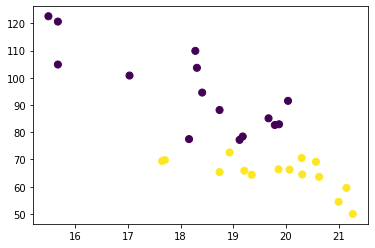

In [ ]:
import matplotlib.pyplot as plt
from sklearn.cluster import SpectralClustering
model = SpectralClustering(n_clusters=2, affinity='nearest_neighbors',
                           assign_labels='kmeans')
XY = np.zeros([len(x),2])
XY[:,0] = x
XY[:,1] = y
labels = model.fit_predict(XY)
plt.scatter(XY[:, 0], XY[:, 1], c=labels,
            s=50, cmap='viridis');

In [ ]:
import numpy as np
from bokeh.plotting import figure, show

# output to notebook 
output_notebook() 

N = 4000
x = np.random.random(size=N) * 100
y = np.random.random(size=N) * 100
radii = np.random.random(size=N) * 1.5
colors = np.array([ [r, g, 150] for r, g in zip(50 + 2*x, 30 + 2*y) ], dtype="uint8")

TOOLS="hover,crosshair,pan,wheel_zoom,zoom_in,zoom_out,box_zoom,undo,redo,reset,tap,save,box_select,poly_select,lasso_select,"

p = figure(tools=TOOLS)

p.scatter(x, y, radius=radii,
          fill_color=colors, fill_alpha=0.6,
          line_color=None)

show(p)

In [ ]:
np.max(raw_format_dataset)

39.47

In [ ]:
max_len = byk_data_kota
print(max_len)

21


In [ ]:
np.random.uniform(low=-0.5, high=0.5, size=(1,3)).flatten()

array([-0.14672328, -0.17756322,  0.36176652])

In [ ]:
raw_format_dataset/100

In [ ]:
# melakukan Autoencoder untuk raw_format_dataset

max_len = byk_data_kota
# Proses Encode data val dengan ELM murni
#set bebas, bisa direduksi (dikecilkan dari dimensi awalnya) atau disparse (dinaikkan dimensinya)
banyak_hidden_neuron_ae_elm = 2
banyak_fitur_elm = N_dimFeature_elm = max_len
# bobot_elm = myrandfloat(banyak_hidden_neuron_ae_elm, banyak_fitur_elm,-0.5,0.5)
bobot_elm = np.random.uniform(low=-0.5, high=0.5, size=(banyak_hidden_neuron_ae_elm,banyak_fitur_elm))

#bias = np.random.rand(banyak_hidden_neuron_ae_kelm)
# flatten() digunakan utk convert ND to 1D array
# bias_elm = myrandfloat(1,banyak_hidden_neuron_ae_elm,0.0000001,0.999999).flatten()
bias_elm = np.random.uniform(low=0.0000001, high=0.999999, size=(1,banyak_hidden_neuron_ae_elm)).flatten()
#print(bobot.round(2))
#print()
#print(bias.round(2))

# membuat name_unik2save utk simpan hasil
name_unik2save = str(datetime.today().astimezone(pytz.timezone('Asia/Jakarta')).strftime('%d-%m-%Y-%H-%M-%S'))
# hasil_txt_Ytrain_predict = arr_token_to_txt('filename_HasilTrain_'+name_unik2save+'.txt',arr_token_Ytrain_predict)

# simpan bobot_input, bias dan bobot_output
# set info_param
# af mewakili parameter activation function
# hd mewakili parameter jumlah_hidden
# fi mewakili jumlah fitur input yg diset
# fif mewakili jumlah fitur input full connected
# ft mewakili jumlah fitur target
# elm_tr_predict (etrp) memakili label kegunaan ELM-nya

af= 'sigmoid'
# af= 'tanh'

if not os.path.exists("HasilAutoencoder"):
  os.makedirs("HasilAutoencoder")
else:
  # print("Folder sdh ada")


info_param = '-Nawal-'+str(banyak_fitur_elm)+'-NhasilEncode-'+str(banyak_hidden_neuron_ae_elm)+'-af-'+af

# nama_path_hasil = './HasilTrainNTest/'+name_unik2save+'/'
nama_path_hasil = './HasilAutoencoder/'+name_unik2save
nama_file_csv_bobot_input = nama_path_hasil+info_param+'_bobot_input.csv'
nama_file_csv_bias = nama_path_hasil+info_param+'_bias.csv'
# nama_file_csv_bobot_output = nama_path_hasil+info_param+'_bobot_output.csv'

bobot_input = bobot_elm
bias = bias_elm
pd.DataFrame(bobot_input).to_csv(nama_file_csv_bobot_input, header=None, index=None)
pd.DataFrame(bias).to_csv(nama_file_csv_bias, header=None, index=None)
# pd.DataFrame(bobot_output).to_csv(nama_file_csv_bobot_output, header=None, index=None)


# Cara baca file csv diatas
baca_bobot_input = pd.read_csv(nama_file_csv_bobot_input, header=None).values
# print('baca_bobot_input: \n', baca_bobot_input,'\n')

baca_bias = pd.read_csv(nama_file_csv_bias,  header=None).values.flat[:]
# print('baca bias: \n', baca_bias,'\n')

# baca_bobot_output = pd.read_csv(nama_file_csv_bobot_output, header=None).values
# print('baca_bobot_output: \n', baca_bobot_output,'\n')


arr_dataset_elm_norm = raw_format_dataset/100
fitur_data_train_elm_norm = arr_dataset_elm_norm
val_round__ = 3
#print()
#Hitung Matrik H sebagai hasil Encoder data training pada Autoencoder
print('Hitung Matrik H sebagai hasil Encoder pada Autoencoder:')
h_elm = 1/(1 + np.exp(-(np.dot(fitur_data_train_elm_norm, np.transpose(bobot_elm)) + bias_elm)))
print(h_elm.round(val_round__))

# import modules 
from bokeh.plotting import figure, output_notebook, show 
  
# output to notebook 
output_notebook() 
  
# create figure 
p = figure(plot_width = 800, plot_height = 300) 

val_round__ = 3

x = h_elm.round(val_round__)[:,0]
y = h_elm.round(val_round__)[:,1]

# untuk val_a_z_seq_complete_human_genome__  
p.circle(x, y, legend_label="Autoencoder 21D to 2D (data suhu)", 
         line_width =2, size = 3, color = "green", alpha = 0.5) 

p.text(x, y, text=["(%d)" % (idx+1) for idx, (x_in, y_in) in enumerate(zip(x, y))],
       text_baseline="middle", text_align="center")

p.legend.location = "center"

p.add_layout(p.legend[0], 'right')
  
# show the results 
show(p)

IndentationError: ignored

In [ ]:
# apply koding untuk proposes iqra' algorithm 
# untuk melakukan cluster "One Against All (OAA)", di mana data one-nya merupakan indikasi Lailatul Qodar (LQ)
# atau menggunakan istilah cluster "one to many" atau "many to one"


# Run Koding JS

In [ ]:
from IPython.display import Javascript 
def show_port(port, height=400): 
  display(Javascript('''
  (async ()=>{ fm = document.createElement('iframe') 
  fm.src = await google.colab.kernel.proxyPort(%s) 
  fm.width = '95%%' 
  fm.height = '%d' 
  fm.frameBorder = 0 
  document.body.append(fm) })(); 
  ''' 
  % (port, height) )) 

In [ ]:
get_ipython().system_raw('python3 -m http.server 8888 &') 
show_port(8888) 

In [ ]:
# 
import os
os.chdir("/content/drive/My Drive")
path = "#Penelitian&Pengmas 2021/DIPA Penelitian 2021/Satria Data - BDC 2021/Prepare - Materi Pendampingan Peserta BDC utk Persiapan Babak Penyisihan Tingkat Filkom UB 2021"
if not os.path.exists(path):
    os.makedirs(path)
os.chdir("#Penelitian&Pengmas 2021/DIPA Penelitian 2021/Satria Data - BDC 2021/Prepare - Materi Pendampingan Peserta BDC utk Persiapan Babak Penyisihan Tingkat Filkom UB 2021")

!pwd
!ls -l -a --block-size=M

/content/drive/My Drive/#Penelitian&Pengmas 2021/DIPA Penelitian 2021/Satria Data - BDC 2021/Prepare - Materi Pendampingan Peserta BDC utk Persiapan Babak Penyisihan Tingkat Filkom UB 2021
total 1M
-rw------- 1 root root 1M May 14  2018 list_location_id.csv


In [ ]:
# Alt. 1:
# ---------
# https://www.weatherapi.com/my/
# user: enterumum@gmail.com
# pwd: AbcdAbcd!23!23
# 
# setting field: https://www.weatherapi.com/my/fields.aspx =>utk setting field-nya
# docs: https://www.weatherapi.com/docs/
# 
# key = '2181c95fd6d746e9a1331323220104'
# http://api.weatherapi.com/v1/current.json?key=2181c95fd6d746e9a1331323220104&q=London


# Alt. 2:
# --------
# Hourly forecast: unavailable
# Daily forecast: unavailable
# Calls per minute: 60
# 3 hour forecast: 5 days 
# https://home.openweathermap.org/myservices 
# key = '7cdce363ecc74c5fa44be2acaa031dbc'
# 
# Examples of API calls:
# ref: https://openweathermap.org/current#current_JSON
# https://api.openweathermap.org/data/2.5/weather?q=London&appid=7cdce363ecc74c5fa44be2acaa031dbc
# https://api.openweathermap.org/data/2.5/weather?q=London,uk&appid={API key}
# https://api.openweathermap.org/data/2.5/weather?lat=35&lon=139&appid={API key}


In [ ]:
# import matplotlib.pyplot as plt
# from mpl_toolkits.mplot3d import Axes3D
# from sklearn.linear_model import LinearRegression
# from random import sample
# import matplotlib.colors as pltc

# ######################################## Data preparation untuk Visualisasi dgn keseluruhan data #########################################
# # ukuran baris = raw_format_dataset_suhu.shape[0]*raw_format_dataset_suhu.shape[1] = byk_hari * byk_data_kota
# # dan perharinya ada 21 titik data dari banyak kota
# byk_data_3D = byk_hari * byk_data_kota
# XY_init_3D = np.zeros([byk_data_3D,3])
# XY_init_3D[:,0] = raw_format_dataset_suhu.flatten()
# XY_init_3D[:,1] = raw_format_dataset_kelembaban.flatten()
# XY_init_3D[:,2] = raw_format_dataset_angin.flatten()

# xx = XY_init_3D[:, 0]
# yy = XY_init_3D[:, 1]
# zz = XY_init_3D[:, 2]

# x_min = np.min(xx)
# x_max = np.max(xx)

# y_min = np.min(yy)
# y_max = np.max(yy)

# z_min = np.min(zz)
# z_max = np.max(zz)

# x_pred = np.linspace(x_min, x_max, 30)  # range 
# y_pred = np.linspace(y_min, y_max, 30)  # range 
# xx_pred, yy_pred = np.meshgrid(x_pred, y_pred)
# model_viz = np.array([xx_pred.flatten(), yy_pred.flatten()]).T

# ############################################## Plot ################################################

# # mencoba buat model
# # X = np.zeros(shape=(nData,nDim_X))
# # X[:,0] = dataset_[:,0] 

# # Y =  np.zeros(shape=(nData,nDim_Y))
# # Y[:,0] = dataset_[:,-2]

# # XY = np.zeros(shape=(nData,nDim_X+nDim_Y))
# # XY[:,:] = dataset_[:,0:2]

# # Z =  np.zeros(shape=(nData,nDim_Z))
# # Z[:,0] = dataset_[:,-1]

# reg = LinearRegression().fit(XY_init_3D[:,0:2], XY_init_3D[:,2])

# predicted = reg.predict(model_viz)

# # 1,2,3
# # 1,3,2
# # 2,3,1

# # r2_suhu_x_kelembaban_y_angin_z = reg.score(XY_init_3D[:,0:2], XY_init_3D[:,2])
# r2_suhu_x_kelembaban_y_angin_z = reg.score(np.vstack((XY_init_3D[:,0],XY_init_3D[:,1])).T, XY_init_3D[:,2])
# r2_suhu_x_angin_y_kelembaban_z = reg.score(np.vstack((XY_init_3D[:,0],XY_init_3D[:,2])).T, XY_init_3D[:,1])
# r2_kelembaban_x_angin_y_suhu_z = reg.score(np.vstack((XY_init_3D[:,1],XY_init_3D[:,2])).T, XY_init_3D[:,0])

# plt.style.use('default')

# fig = plt.figure(figsize=(15, 7))

# ax1 = fig.add_subplot(131, projection='3d')
# ax2 = fig.add_subplot(132, projection='3d')
# ax3 = fig.add_subplot(133, projection='3d')

# axes = [ax1, ax2, ax3]

# all_colors = [k for k,v in pltc.cnames.items()]

# colors = sample(all_colors, byk_hari)
# # print(colors)

# colors = np.repeat(colors, byk_data_kota)

# for ax in axes:
#     # ax.plot(xx, yy, zz, color='k', zorder=15, linestyle='none', marker='o', alpha=0.5)
#     # ax.plot(xx, yy, zz, color=list(colors), zorder=15, linestyle='none', marker='o', alpha=0.5)
#     # ax.scatter(xx_pred.flatten(), yy_pred.flatten(), predicted, facecolor=(0,0,0,0), s=10, edgecolor='#70b3f0')
#     ax.scatter(xx, yy, zz, facecolor=colors, s=50, edgecolor='#70b3f0')
#     ax.set_xlabel('X = suhu', fontsize=12)
#     ax.set_ylabel('Y = kelembaban', fontsize=12)
#     ax.set_zlabel('Z = kecepatan angin', fontsize=12)
#     ax.locator_params(nbins=4, axis='x')
#     ax.locator_params(nbins=5, axis='x')

# # for idx, (x_in, y_in, z_in) in enumerate(zip(xx, yy, zz)):
# #   label = idx
# #   ax1.text(x_in, y_in, z_in, '%s' % (label), size=20, zorder=1, color='k')




# ax1.view_init(elev=27, azim=112)
# ax2.view_init(elev=16, azim=-51)
# ax3.view_init(elev=60, azim=165)

# fig.suptitle('$R^2 | (suhu (x), kelembaban (y), angin (z)) = ' + str(round(r2_suhu_x_kelembaban_y_angin_z,2)) + ',  (suhu (x), angin (y), kelembaban (z)) = ' + str(round(r2_suhu_x_angin_y_kelembaban_z,2)) + ',  (kelembaban (x), angin (y), suhu (z)) = %.2f$' % r2_kelembaban_x_angin_y_suhu_z, fontsize=12)
# # fig.suptitle('$R^2 = %.2f$' % r2, fontsize=12)

# fig.tight_layout()

In [ ]:
import numpy as np
from sklearn import cluster, datasets
from sklearn.preprocessing import StandardScaler

from bokeh.layouts import column, row
from bokeh.plotting import figure, output_file, show

print("\n\n*** This example may take several seconds to run before displaying. ***\n\n")

N = 50000
PLOT_SIZE = 400

# generate datasets.
np.random.seed(0)
noisy_circles = datasets.make_circles(n_samples=N, factor=.5, noise=.04)
noisy_moons = datasets.make_moons(n_samples=N, noise=.05)
centers = [(-2, 3), (2, 3), (-2, -3), (2, -3)]
blobs1 = datasets.make_blobs(centers=centers, n_samples=N, cluster_std=0.4, random_state=8)
blobs2 = datasets.make_blobs(centers=centers, n_samples=N, cluster_std=0.7, random_state=8)

colors = np.array([x for x in ('#00f', '#0f0', '#f00', '#0ff', '#f0f', '#ff0')])
colors = np.hstack([colors] * 20)

# create clustering algorithms
dbscan   = cluster.DBSCAN(eps=.2)
birch    = cluster.Birch(n_clusters=2)
means    = cluster.MiniBatchKMeans(n_clusters=2)
spectral = cluster.SpectralClustering(n_clusters=2, eigen_solver='arpack', affinity="nearest_neighbors")
affinity = cluster.AffinityPropagation(damping=.9, preference=-200)

# change here, to select clustering algorithm (note: spectral is slow)
algorithm = dbscan  # <- SELECT ALG

plots =[]
for dataset in (noisy_circles, noisy_moons, blobs1, blobs2):
    X, y = dataset
    X = StandardScaler().fit_transform(X)

    # predict cluster memberships
    algorithm.fit(X)
    if hasattr(algorithm, 'labels_'):
        y_pred = algorithm.labels_.astype(int)
    else:
        y_pred = algorithm.predict(X)

    p = figure(output_backend="webgl", title=algorithm.__class__.__name__,
               width=PLOT_SIZE, height=PLOT_SIZE)

    p.circle(X[:, 0], X[:, 1], color=colors[y_pred].tolist(), alpha=0.1,)

    plots.append(p)

# generate layout for the plots
layout = column(row(plots[:2]), row(plots[2:]))

output_file("clustering.html", title="clustering with sklearn")

show(layout)



*** This example may take several seconds to run before displaying. ***




In [ ]:
#Done :D

In [2]:
import numpy as np
print((np.pi**2) /6)

1.6449340668482264


In [3]:
hasil = 0
for i in range(10+1):
  hasil+=1/((i+1)**2)

print(hasil)

1.558032193976458


In [6]:
hasil = 0
for i in range(100+1):
  hasil+=1/((i+1)**2)

print(hasil)

1.635081929789833


In [7]:
hasil = 0
for i in range(1000+1):
  hasil+=1/((i+1)**2)

print(hasil)

1.6439355646845575


In [8]:
hasil = 0
for i in range(10000+1):
  hasil+=1/((i+1)**2)

print(hasil)

1.6448340818460654


In [4]:
hasil = 0
for i in range(10+1):
  hasil+=1/((i+1))

print(hasil)

3.0198773448773446


In [5]:
hasil = 0
for i in range(100+1):
  hasil+=1/((i+1))

print(hasil)

5.1972785077386305


In [9]:
hasil = 0
for i in range(1000+1):
  hasil+=1/((i+1))

print(hasil)

7.486469861549344


In [10]:
hasil = 0
for i in range(10000+1):
  hasil+=1/((i+1))

print(hasil)

9.787706026045347


In [11]:
hasil = 0
for i in range(100000+1):
  hasil+=1/((i+1))

print(hasil)

12.090156129763336


In [12]:
hasil = 0
for i in range(1000000+1):
  hasil+=1/((i+1))

print(hasil)

14.392727722863988


In [13]:
hasil = 0
for i in range(10000000+1):
  hasil+=1/((i+1))

print(hasil)

16.695311465857262


In [14]:
hasil = 0
for i in range(100000000+1):
  hasil+=1/((i+1))

print(hasil)

18.997896423852556


In [15]:
hasil = 0
for i in range(1000000000+1):
  hasil+=1/((i+1))

print(hasil)

21.30048150334855


Semoga Bermanfaat. Aamiin. :D
![]( https://docs.google.com/uc?export=download&id=1vJNmuncRehLc3WCZkFYCU6rRMVTy-w0k)